In [1]:
%load_ext autoreload
%autoreload 1

from AirSeaFluxCode import AirSeaFluxCode
import xarray as xr
import gsw_xarray as gsw
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import numpy as np
import gsw_xarray as gsw
import cartopy.crs as ccrs
import cmocean.cm as cmo

%aimport my_funcs

my_funcs.update_params(fontsize=24)

In [2]:
def fix_xticks(ax):
    ax.xaxis.set_minor_locator(mdates.MonthLocator())
    ax.xaxis.set_major_locator(mdates.MonthLocator())
    ax.xaxis.set_major_formatter(mdates.DateFormatter("%b"))
    ax.xaxis.set_minor_formatter(mdates.DateFormatter("%b"))
    #ax.set_xlim(ds.time[0] - np.timedelta64(6,'H'),ds.time[-1] + np.timedelta64(6,'H'))
    ax.set_xlabel('2019')


In [3]:
c20 = "#C13F89"
c22 = "#3ec177"
c23 = "#3e88c1"
ext = "#a43ec1"

In [4]:
adcp = xr.open_dataset('../data/saildrone-gen_5-antarctica_circumnavigation_2019-sd1020-20190119T040000-20190803T043000-1_minutes-v1.1597092482498.nc')
ds20 = xr.open_dataset('../data/saildrone-gen_5-antarctica_circumnavigation_2019-sd1020-20190119T040000-20190803T043000-1_minutes-v1.1620360815446.nc')
ds20 = ds20.squeeze().swap_dims({'obs':'time'})

ds22 = xr.open_dataset('../data/Sd1022_data_merged.nc').set_coords(['longitude','latitude'])
ds23 = xr.open_dataset('../data/Sd1023_data_merged.nc').set_coords(['longitude','latitude'])

In [5]:
adcp = adcp.squeeze().swap_dims({'obs':'time'})

In [6]:
times = ['2019-02-08T15:50:00.000000000', '2019-03-26T13:49:00.000000000']

In [7]:
var = ['RH_MEAN','UWND_MEAN','VWND_MEAN','WWND_MEAN','BARO_PRES_MEAN','TEMP_CTD_RBR_MEAN','SAL_RBR_MEAN']
var = ['TEMP_AIR_MEAN','RH_MEAN','UWND_MEAN','BARO_PRES_MEAN','TEMP_CTD_RBR_MEAN','SAL_RBR_MEAN']
c = ['C0','C1','C2','C3','C4','C5']

## Calculate wind speed and air-sea fluxes

In [8]:
def calc_ws(ds):
    ds['wind_speed'] = np.sqrt(ds['UWND_MEAN']**2 + ds['VWND_MEAN']**2)
    return ds

In [9]:
ds20 = calc_ws(ds20)
ds22 = calc_ws(ds22)
ds23 = calc_ws(ds23)

In [10]:
def calc_tasf(ds):

        # Convert ship data into NumPy arrays
    lat  = np.asarray(ds["latitude"])               # Latitude
    spd  = np.asarray(ds["wind_speed"])               # Wind speed
    t    = np.asarray(ds["TEMP_AIR_MEAN"])               # Air temperature
    sst  = np.asarray(ds["TEMP_CTD_RBR_MEAN"])               # Sea surface temperature
    rh   = np.asarray(ds["RH_MEAN"])               # Relative humidity
    
    # Initialize a constant
    hin  = 17  # Height of the sensors (17 meters)
    
    # Calculate temperature at 2 meters above the sea surface ('t10n') and relative and specific humidity at 2 meters above the sea surface ('rh','q10n')
    
    air_hum = AirSeaFluxCode(spd, 
                                         t, 
                                         sst, 
                                         "skin", 
                                         meth = "C35", 
                                         lat = lat, 
                                         hin = [3.68,2.5,2.5], 
                                         hout = 2,
                                         hum=["rh", rh], 
                                         out_var = ["tref","rh", "qref",'qair','qsea'])
    
    # Calculate horizontal wind speed at 10 meters above the sea surface ('u10n')
    wind = AirSeaFluxCode(spd, 
                                         t, 
                                         sst, 
                                         "skin", 
                                         meth = "C35", 
                                         lat = lat, 
                                         hin = [3.68,2.5,2.5], 
                                         hout = 10,
                                         out_var = ["uref",'latent','sensible'])
    
    
    
    # Assign the calculated temperature values (converted to degrees Celsius) at 2 meters above the sea surface to the 't2m' column
    ds['t2m'] = ('time'), air_hum['tref'] - 273.15
    
    # Assign the calculated horizontal wind speed values at 10 meters above the sea surface to the 'u10' column
    ds['u10'] = ('time'), wind['uref']
    
    # Assign the calculated specific humidity values at 2 meters above the sea surface (converted to g/kg) to the 'qref' column
    ds['rh_corr'] = ('time'), air_hum['rh']
    ds['qref'] = ('time'), air_hum['qref']*1000
    ds['qair'] = ('time'), air_hum['qair']*1000
    ds['qsea'] = ('time'), air_hum['qsea']*1000
    
    # Assign some flags or indicators to the 'flags' column
    ds['flags'] = ('time'), wind['flag']
    
    # Assign some flags or indicators to the 'flags' column
    ds['sensible'] = ('time'), wind['sensible']
    ds['latent'] = ('time'), wind['latent']

    return ds

In [11]:
ds20 = calc_tasf(ds20)
ds22 = calc_tasf(ds22)
ds23 = calc_tasf(ds23)

In [ ]:
29510
95630

In [12]:
ds = ds20.isel(time=slice(0,95630))

In [13]:
ds5 = ds.reset_coords().resample(time='5min').mean('time')


KeyboardInterrupt



In [15]:
ds5['GUST_WND_MEAN'] = ds['GUST_WND_MEAN'].resample(time='5min').max('time')

In [16]:
ds5['longitude'] = ds['longitude'].resample(time='5min').mean('time')
ds5['latitude'] = ds['latitude'].resample(time='5min').mean('time')

In [42]:
list(ds5.keys())

['SOG',
 'COG',
 'HDG',
 'HDG_WING',
 'WING_ANGLE',
 'UWND_MEAN',
 'UWND_STDDEV',
 'VWND_MEAN',
 'VWND_STDDEV',
 'WWND_MEAN',
 'WWND_STDDEV',
 'GUST_WND_MEAN',
 'GUST_WND_STDDEV',
 'WIND_MEASUREMENT_HEIGHT_MEAN',
 'WIND_MEASUREMENT_HEIGHT_STDDEV',
 'TEMP_AIR_MEAN',
 'TEMP_AIR_STDDEV',
 'RH_MEAN',
 'RH_STDDEV',
 'BARO_PRES_MEAN',
 'BARO_PRES_STDDEV',
 'PAR_AIR_MEAN',
 'PAR_AIR_STDDEV',
 'TEMP_IR_SEA_WING_UNCOMP_MEAN',
 'TEMP_IR_SEA_WING_UNCOMP_STDDEV',
 'WAVE_DOMINANT_PERIOD',
 'WAVE_SIGNIFICANT_HEIGHT',
 'TEMP_CTD_RBR_MEAN',
 'TEMP_CTD_RBR_STDDEV',
 'SAL_RBR_MEAN',
 'SAL_RBR_STDDEV',
 'COND_RBR_MEAN',
 'COND_RBR_STDDEV',
 'O2_CONC_AANDERAA_MEAN',
 'O2_CONC_AANDERAA_STDDEV',
 'O2_SAT_AANDERAA_MEAN',
 'O2_SAT_AANDERAA_STDDEV',
 'TEMP_O2_AANDERAA_MEAN',
 'TEMP_O2_AANDERAA_STDDEV',
 'O2_TC_PHASE_AANDERAA_MEAN',
 'O2_TC_PHASE_AANDERAA_STDDEV',
 'O2_CONC_RBR_MEAN',
 'O2_CONC_RBR_STDDEV',
 'O2_SAT_RBR_MEAN',
 'O2_SAT_RBR_STDDEV',
 'TEMP_O2_RBR_MEAN',
 'TEMP_O2_RBR_STDDEV',
 'CHLOR_RBR_MEAN',


In [36]:
ds5.to_netcdf('../data/sd1020_5min.nc')

In [12]:
ds5 = xr.open_dataset('../data/sd1020_5min.nc')

In [13]:
ds5 = ds5.interpolate_na('time')

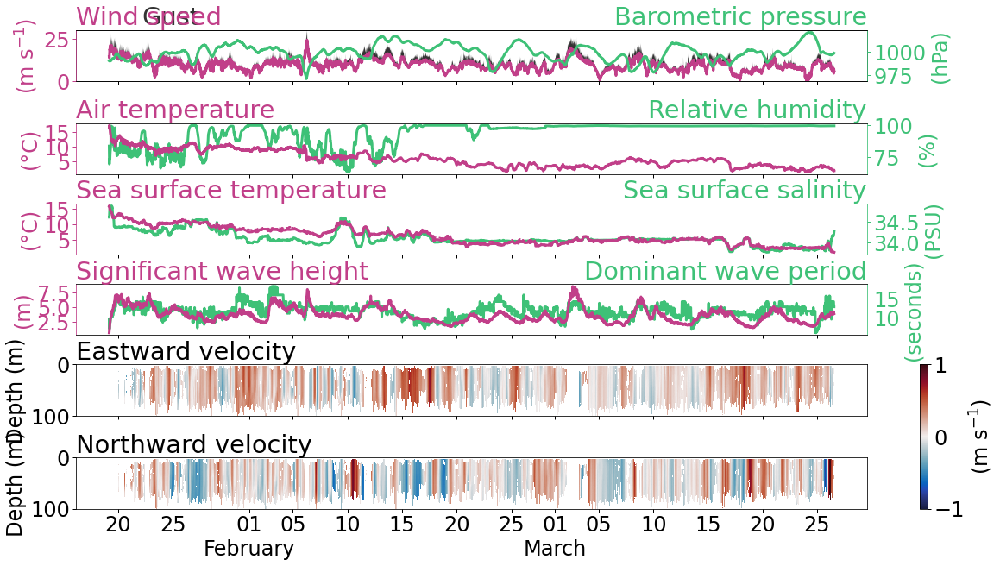

In [218]:
# Create subplots
fig, ax = plt.subplots(6, 1, figsize=(16, 9), constrained_layout=True, sharex=True, dpi=72)

bx = []  # List to store twin axes

lw = 3  # Line width

# Define variables, labels, and units for left and right y-axes
variables_l = ['wind_speed', 'TEMP_AIR_MEAN', "TEMP_CTD_RBR_MEAN", "WAVE_SIGNIFICANT_HEIGHT"]
label_l = ['Wind speed', 'Air temperature', "Sea surface temperature", "Significant wave height"]
units_l = ['(m s$^{-1}$)', '(°C)', "(°C)", "(m)"]

variables_r = ['BARO_PRES_MEAN', 'RH_MEAN', "SAL_RBR_MEAN", "WAVE_DOMINANT_PERIOD"]
label_r = ['Barometric pressure', 'Relative humidity', "Sea surface salinity", "Dominant wave period"]
units_r = ["(hPa)", '(%)', "(PSU)", "(seconds)"]

# Loop through the axes
for axs, lvar, llabel, lunit, rvar, rlabel, runit in zip(ax, variables_l, label_l, units_l, variables_r, label_r,
                                                          units_r):
    # Create twin axes
    bxs = axs.twinx()
    bx.append(bxs)

    # Plot data on left axis
    full[lvar].rolling(time=3, center=True).median('time').plot(ax=axs, lw=lw, c=c20, zorder=2)

    if lvar == "TEMP_CTD_RBR_MEAN":
        full["TEMP_IR_SEA_WING_UNCOMP_MEAN"].rolling(time=3, center=True).median('time').plot(ax=axs, lw=2, ls='--', c=c20, zorder=2)

    
    axs.set(title='', xlabel='', ylabel=lunit)
    axs.set_title(llabel, loc='left', c=c20, fontweight='normal')
    bxs.set_title(rlabel, loc='right', c=c22, fontweight='normal')

    # Adjust ylim for wind_speed
    if lvar == "wind_speed":
        axs.set_ylim(0, 30)
        axs.fill_between(full['time'], full[lvar], full["GUST_WND_MEAN"], fc="0.2", alpha=1, lw=0, label=rlabel)
        axs.set_title("Gust", loc='center', c="0.2", fontweight='normal', x=0.12)

    # Plot data on right axis
    full[rvar].rolling(time=3, center=True).median('time').plot(ax=bxs, lw=lw, c=c22)
    bxs.set(title='', xlabel='', ylabel=runit)

    # Adjust z-order and frame for non-wind_speed plots
    if lvar != "wind_speed":
        axs.set_zorder(axs.get_zorder() + 1)
        axs.set_frame_on(False)

    # Set colors for left and right axes
    axs.tick_params(axis='y', colors=c20)
    axs.yaxis.label.set_color(c20)
    bxs.spines['left'].set_color(c20)
    bxs.tick_params(axis='y', colors=c22)
    bxs.yaxis.label.set_color(c22)
    bxs.spines['right'].set_color(c22)

    # Hide top spine for both axes
    #axs.spines['top'].set_visible(False)
    #bxs.spines['top'].set_visible(False)
    

variables = ["vel_east","vel_north","vel_up"]
vmins = [-1,-1,-0.05]
vmaxs = [1,1,0.05]
titles = ['Eastward velocity', 'Northward velocity', 'Upward velocity']

for axs,var,vmin,vmax,title in zip(ax[4:],variables,vmins,vmaxs,titles):
    img = adcp5[var].where(adcp5["percent_good"]>85).rolling(time=6,center=True).mean("time").plot(ax=axs,y="cell_depth",vmin=vmin,vmax=vmax,cmap="cmo.balance",ylim=(100,0),add_colorbar=False)
    axs.set(xlabel='',ylabel="Depth (m)",title="")
    axs.set_title(title,loc='left',fontweight='normal')

plt.colorbar(img,pad=-0.038,label="(m s$^{-1}$)",ax=ax[4:])

# Call function to fix x-axis ticks
my_funcs.fix_xticks(ax, full)

In [283]:
adcp

<xarray.Dataset>
Dimensions:              (trajectory: 1, cell_depth: 50, obs: 38105, beam: 4)
Coordinates:
  * trajectory           (trajectory) float32 1.02e+03
  * cell_depth           (cell_depth) float64 4.2 6.2 8.2 ... 98.2 100.2 102.2
    time                 (trajectory, obs) datetime64[ns] 2019-01-19T04:00:00...
    latitude             (trajectory, obs) float64 ...
    longitude            (trajectory, obs) float64 ...
Dimensions without coordinates: obs, beam
Data variables: (12/28)
    roll                 (trajectory, obs) float64 ...
    pitch                (trajectory, obs) float64 ...
    heading              (trajectory, obs) float64 ...
    vel_east             (trajectory, obs, cell_depth) float64 ...
    vel_north            (trajectory, obs, cell_depth) float64 ...
    vel_up               (trajectory, obs, cell_depth) float64 ...
    ...                   ...
    bt_vel_up            (trajectory, obs) float64 ...
    bt_amp               (trajectory, obs, beam) float64 ...
    bt_percent_good      (trajectory, obs, beam) float64 ...
    percent_good_4_beam  (trajectory, obs, cell_depth) float64 ...
    percent_good_3_beam  (trajectory, obs, cell_depth) float64 ...
    percent_good         (trajectory, obs, cell_depth) float64 ...
Attributes: (12/38)
    description:                     Saildrone NetCDF Format
    Metadata_Conventions:            Unidata Dataset Discovery v1.0
    keywords:                        ADCP,Saildrone
    geospatial_vertical_units:       meters
    geospatial_lon_units:            degrees_east
    geospatial_lat_units:            degrees_north
    ...                              ...
    geospatial_lat_max:              -46.68317215517163
    geospatial_lon_min:              168.51712797302753
    geospatial_lon_max:              168.5914306109771
    geospatial_vertical_positive:    down
    wmo_id:                          4803902
    license:                         2019 © SAILDRONE Inc.  All Rights Reserv...

(0.0, 11.0)

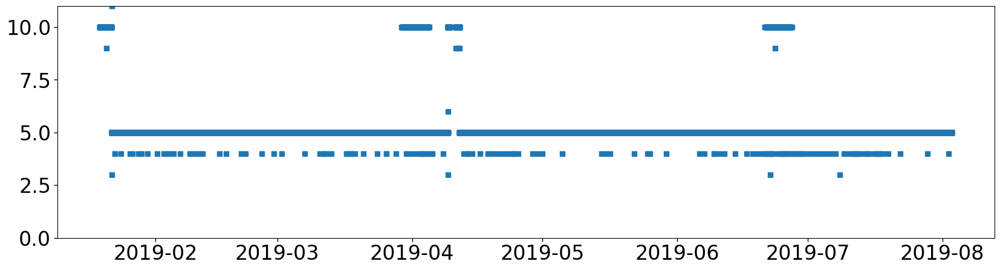

In [286]:
plt.figure(figsize=(20,5))
plt.plot(adcp.time[1:],adcp.time.diff('time').values.astype("timedelta64[m]"),ls='',marker='s')
plt.gca().set_ylim(0,11)

In [219]:
ds['SAL_RBR_MEAN']

<xarray.DataArray 'SAL_RBR_MEAN' (time: 136974)>
[136974 values with dtype=float64]
Coordinates:
    latitude    (time) float64 ...
    longitude   (time) float64 ...
  * time        (time) datetime64[ns] 2019-05-10 ... 2019-08-24T23:56:00
    trajectory  float32 ...
Attributes:
    standard_name:              sea_water_practical_salinity
    long_name:                  Seawater salinity
    units:                      1
    last_calibrated:            2018-11-08
    update_period:              500
    device_name:                RBR CTD/ODO/Chl-A (40743)
    installed_date:             2019-03-07T19:12:51.642264Z
    nominal_sampling_schedule:  12s on, 48s off, centered at :00
    installed_height:           -0.53
    serial_number:              40743
    vendor_name:                RBR
    model_name:                 Saildrone^3

In [18]:
ds['SAL_RBR_MEAN'] = ds['SAL_RBR_MEAN'].rolling(time=3,center=True).median('time')
ds['SAL_RBR_MEAN'] = ds['SAL_RBR_MEAN'].where(ds['SAL_RBR_MEAN']>33.5).interpolate_na('time')

In [225]:
ds.sel(time=slice(ds5.time[0].values,ds5.time[-1].values))['SAL_RBR_MEAN'].plot()

TypeError: No numeric data to plot.

In [226]:
ds

<xarray.Dataset>
Dimensions:                        (time: 136974)
Coordinates:
    latitude                       (time) float64 ...
    longitude                      (time) float64 ...
  * time                           (time) datetime64[ns] 2019-05-10 ... 2019-...
    trajectory                     float32 ...
Data variables: (12/45)
    SOG                            (time) float64 ...
    COG                            (time) float64 ...
    HDG                            (time) float64 ...
    HDG_WING                       (time) float64 ...
    ROLL                           (time) float64 ...
    PITCH                          (time) float64 ...
    ...                             ...
    O2_AANDERAA_SAT_MEAN           (time) float64 ...
    O2_AANDERAA_SAT_STDDEV         (time) float64 ...
    TEMP_O2_AANDERAA_MEAN          (time) float64 ...
    TEMP_O2_AANDERAA_STDDEV        (time) float64 ...
    CHLOR_RBR_MEAN                 (time) float64 ...
    CHLOR_RBR_STDDEV               (time) float64 ...
Attributes: (12/33)
    title:                     Antarctic Circumnavigation Near-Real-Time Data
    summary:                   Antarctic Circumnavigation Mission
    ncei_template_version:     NCEI_NetCDF_Trajectory_Template_v2.0
    Conventions:               CF-1.6, ACDD-1.3
    netcdf_version:            4.4.1.1
    featureType:               trajectory
    ...                        ...
    geospatial_lat_min:        -47.473408
    geospatial_lat_max:        -46.6894848
    geospatial_lat_units:      degrees_north
    geospatial_lon_min:        168.287232
    geospatial_lon_max:        169.2664704
    geospatial_lon_units:      degrees_east

#### Salinity QC

In [19]:
ds5['SAL_RBR_MEAN'] = ds5['SAL_RBR_MEAN'].rolling(time=3,center=True).median('time')
ds5['SAL_RBR_MEAN'] = ds5['SAL_RBR_MEAN'].where(ds5['SAL_RBR_MEAN']>33.5).interpolate_na('time')

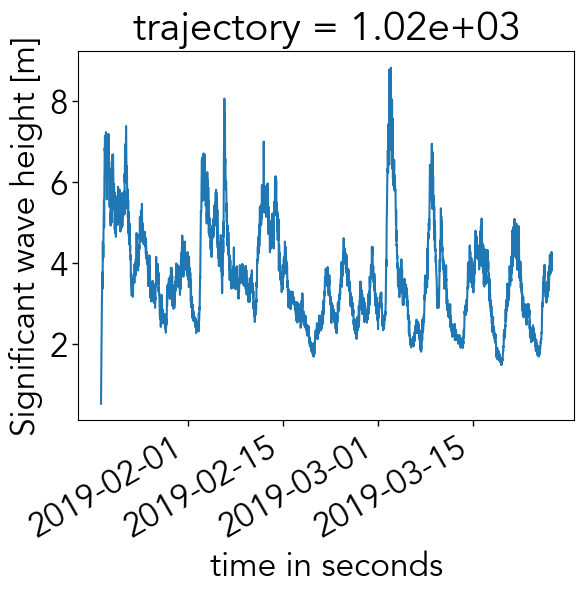

In [66]:
ds5['WAVE_SIGNIFICANT_HEIGHT'].plot()

In [33]:
adcp['vel_north']

<xarray.DataArray 'vel_north' (time: 38105, cell_depth: 50)>
[1905250 values with dtype=float64]
Coordinates:
    trajectory  float32 1.02e+03
  * cell_depth  (cell_depth) float64 4.2 6.2 8.2 10.2 ... 96.2 98.2 100.2 102.2
  * time        (time) datetime64[ns] 2019-01-19T04:00:00 ... 2019-08-03T04:2...
    latitude    (time) float64 ...
    longitude   (time) float64 ...
Attributes:
    standard_name:         northward_sea_water_velocity
    long_name:             North velocity
    units:                 ms-1
    vendor_name:           Teledyne
    model_name:            Workhorse WHM300-I-UG1
    serial_number:         24532
    sampling_description:  300s on, 300s off, centered at :00
    installed_height:      -1.9
    calibration_date:      2019-02-13
    install_date:          2018-06-07T22:31:05.192250Z
    product_page:          http://rdinstruments.com/product/adcp/sentinel-adcp

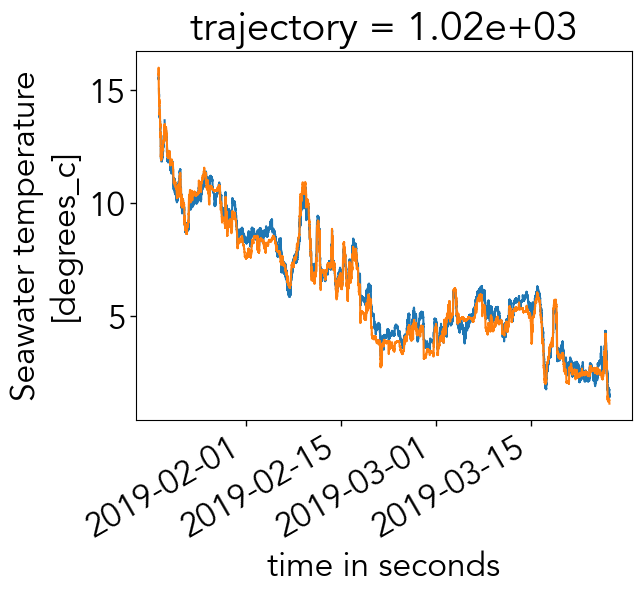

In [20]:
ds['TEMP_IR_SEA_WING_UNCOMP_MEAN'].plot()
ds['TEMP_CTD_RBR_MEAN'].plot()

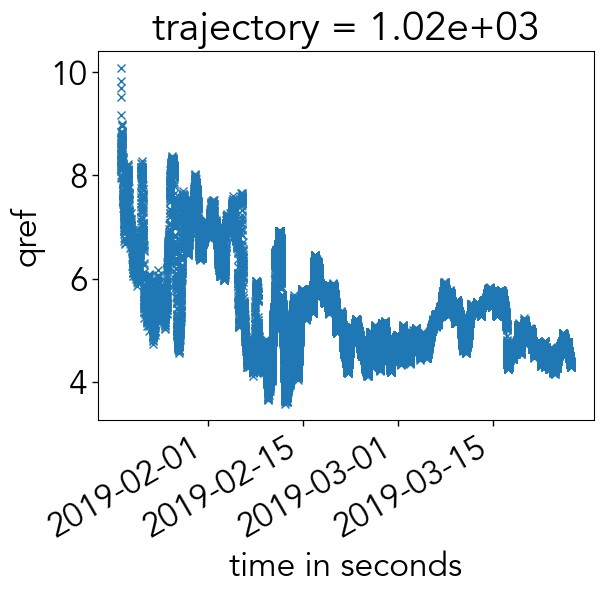

In [23]:
ds['qref'].plot(marker='x')

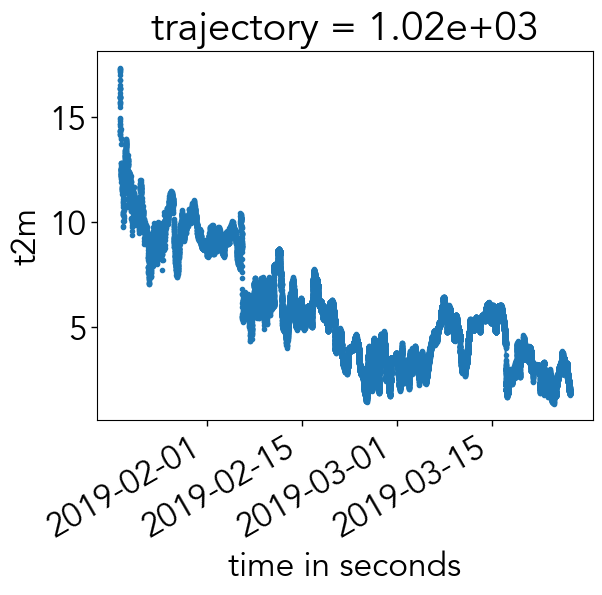

In [26]:
ds['t2m'].plot(marker='.')

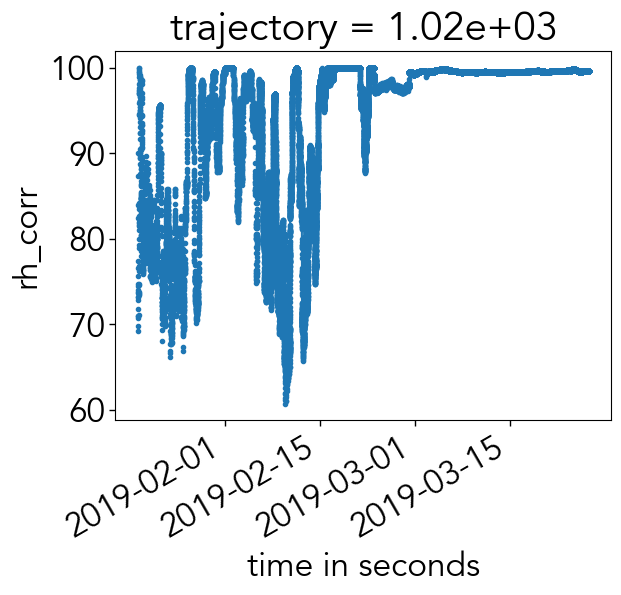

In [27]:
ds['rh_corr'].plot(marker='.')

## Plot data availability

Text(2019-02-01, 1.8, 'Data availability')

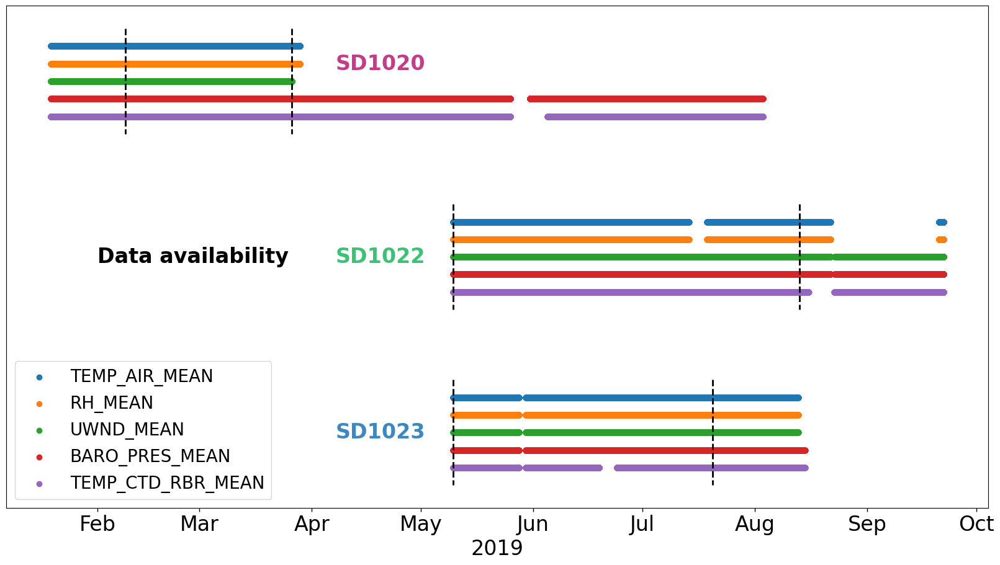

In [307]:
fig, ax = plt.subplots(figsize=(16,9),constrained_layout=True)

var = ['TEMP_AIR_MEAN','RH_MEAN','UWND_MEAN','BARO_PRES_MEAN','TEMP_CTD_RBR_MEAN']#,'SAL_RBR_MEAN']
c = ['C0','C1','C2','C3','C4','C5']

for ds,y,x1,x2 in zip([ds20,ds22,ds23],[3,2,1],[29510,0,0],[95630,137287,100000]):
    for d,(v,col) in enumerate(zip(var,c)):
        msk = np.where(np.isfinite(ds[v]))[0]
        if y == 3:
            ax.scatter(ds.time.values[msk],[y-0.1*d]*len(msk),c=col, label=v)
        else:
            ax.scatter(ds.time.values[msk],[y-0.1*d]*len(msk),c=col)
    
    ax.plot([ds.time[x1].values, ds.time[x1].values],[y+0.1,y-d*0.1-0.1],lw=2,ls='--',c='k')
    ax.plot([ds.time[x2].values, ds.time[x2].values],[y+0.1,y-d*0.1-0.1],lw=2,ls='--',c='k')

fix_xticks(ax)
ax.set_yticks([])
ax.legend(loc='lower left', fontsize='small')

ax.text(np.datetime64("2019-04-20"),3-0.1, 'SD1020', fontweight='bold',c=c20, ha='center', va='center')
ax.text(np.datetime64("2019-04-20"),2-0.2, 'SD1022', fontweight='bold',c=c22, ha='center', va='center')
ax.text(np.datetime64("2019-04-20"),1-0.2, 'SD1023', fontweight='bold',c=c23, ha='center', va='center')

ax.text(np.datetime64("2019-02-01"),2-0.2, 'Data availability', fontweight='bold', c='k', ha='left', va='center')

#ax.text(np.datetime64("2019-02-01"),2-0.2, 'Data availability', fontweight='bold',c='k', ha='left', va='center')


[]

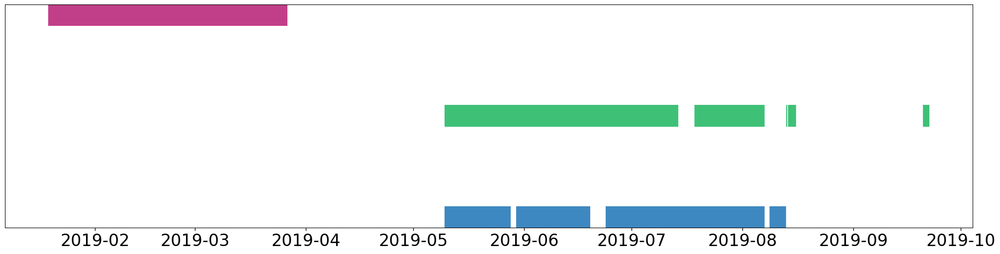

In [308]:
fig, ax = plt.subplots(figsize=(20,5),constrained_layout=True)
masks = []
dm = []
for ds,y,c in zip([ds20,ds22,ds23],[3,2,1],[c20,c22,c23]):
    #for d,(v,col) in enumerate(zip(var,c)):
    msk = np.where(np.logical_and(np.isfinite(ds[var[0]]),
                   np.logical_and(np.isfinite(ds[var[1]]),
                   np.logical_and(np.isfinite(ds[var[2]]),
                   np.logical_and(np.isfinite(ds[var[3]]),np.isfinite(ds[var[4]]))))))[0]
    masks.append(msk)
    dm.append(np.diff(msk))
    #dm = dm[dm<1000]
    ax.scatter(ds.time.values[msk],[y]*len(msk),c=c, s=1000,marker='|')
ax.set_yticks([])

In [333]:
def plot_sample_freq(ax,bx,ds,c,x1,x2,i,t,y=False,):
    
    ax.scatter(ds.time.values[masks[i]][1:],dm[i],marker='s',s=12,c=c)
    
    msk = np.where(np.logical_and(ds.time.values[masks[i]] > ds.time.values[x1],
                                  ds.time.values[masks[i]] < ds.time.values[x2]))[0]

    h = bx.hist(dm[i][msk],bins=np.arange(0,35,1),orientation='horizontal',align='left',fc=c,ec="None")
    bx.text(h[0][1],h[1][1]+1,(int(h[0][1])),ha='right', va='center',c='k',fontsize=16)
    bx.text(h[0][5],h[1][5]+1,(int(h[0][5])),ha='right', va='center',c='k',fontsize=16)
    if h[0][10] > 0:
        bx.text(h[0][10],h[1][10]+1,(int(h[0][10])),ha='right', va='center',c='k',fontsize=16)
    bx.set(xscale='log')
    bx.set_title(t,loc='right',y=0.85,x=0.95,fontweight='normal',va='center',c=c)
    ax.set(ylabel='Sampling frequency (minutes)' if y==True else '', ylim=(-1,35))
    
    ax.axvline(ds.time.values[x1],c='k',ls='--')
    ax.axvline(ds.time.values[x2],c='k',ls='--')
    

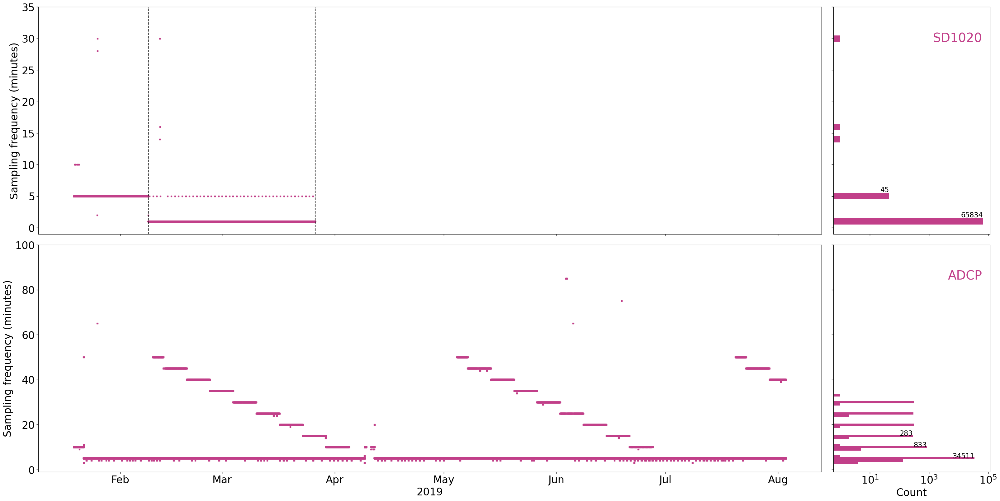

In [335]:
fig, ax = plt.subplots(2,2,figsize=(32,16),width_ratios=[5,1],sharey='row', sharex='col', constrained_layout=True)

plot_sample_freq(ax[0][0],ax[0][1],ds20,c20,29510,95630,0,'SD1020',y=True)
#plot_sample_freq(ax[1][0],ax[1][1],ds22,c22,0,137287,1,'SD1022')
#plot_sample_freq(ax[2][0],ax[2][1],ds23,c23,0,100000-1,2,'SD1023')

dms = (adcp.time.diff('time').values.astype("timedelta64[m]")).astype(int)

ax[1][0].scatter(adcp.time[1:].values,dms,ls='',marker='s',s=12,c=c20)
h = ax[1][1].hist(dms,bins=np.arange(0,35,1),orientation='horizontal',align='left',fc=c20,ec="None")

#ax[3][1].text(h[0][1],h[1][1]+2,(int(h[0][1])),ha='right', va='center',c='k',fontsize=8)
ax[1][1].text(h[0][5],h[1][5]+1,(int(h[0][5])),ha='right', va='center',c='k',fontsize=16)
ax[1][1].text(h[0][10],h[1][10]+1,(int(h[0][10])),ha='right', va='center',c='k',fontsize=16)
ax[1][1].text(h[0][15],h[1][15]+1,(int(h[0][15])),ha='right', va='center',c='k',fontsize=16)
ax[1][1].set_title("ADCP",loc='right',y=0.85,x=0.95,fontweight='normal',va='center',c=c20)
ax[1][0].set(ylabel='Sampling frequency (minutes)',ylim=(-1,100))

ax[1][1].set(xlabel="Count")
fix_xticks(ax[1][0])
plt.show()

(0.0, 11.0)

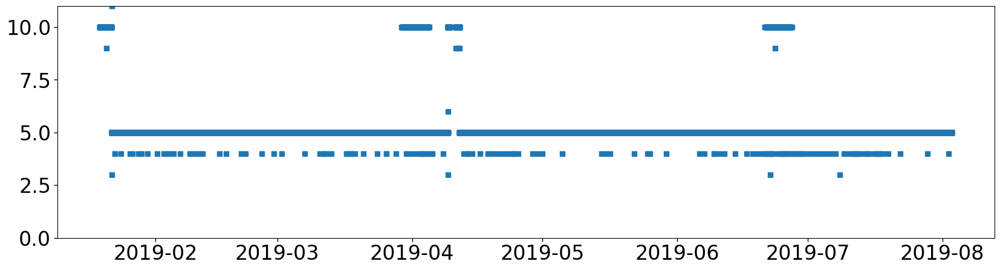

In [290]:
plt.figure(figsize=(20,5))
ax.plot(adcp.time[1:],adcp.time.diff('time').values.astype("timedelta64[m]"),ls='',marker='s')
ax.set_ylim(0,11)

In [ ]:
def plot_sample_freq(ax,bx,ds,c,x1,x2,i,t,y=False,):
    
    ax.scatter(ds.time.values[masks[i]][1:],dm[i],marker='s',s=12,c=c)
    
    msk = np.where(np.logical_and(ds.time.values[masks[i]] > ds.time.values[x1],
                                  ds.time.values[masks[i]] < ds.time.values[x2]))[0]

    h = bx.hist(dm[i][msk],bins=np.arange(0,35,1),orientation='horizontal',align='left',fc=c,ec="None")
    bx.text(h[0][1],h[1][1]+2,(int(h[0][1])),ha='right', va='center',c='k',fontsize=8)
    bx.text(h[0][5],h[1][5]+2,(int(h[0][5])),ha='right', va='center',c='k',fontsize=8)
    if h[0][10] > 0:
        bx.text(h[0][10],h[1][10]+2,(int(h[0][10])),ha='right', va='center',c='k',fontsize=8)
    bx.set(xscale='log')
    bx.set_title(t,loc='right',y=0.85,x=0.95,fontweight='bold',va='center',c=c)
    ax.set(ylabel='Sampling frequency (minutes)' if y==True else '', ylim=(-1,35))
    
    ax.axvline(ds.time.values[x1],c='k',ls='--')
    ax.axvline(ds.time.values[x2],c='k',ls='--')
    

In [12]:
for v in var:
    print(ds20[v].attrs['nominal_sampling_schedule'],':',v)

60s on, 240s off, centered at :00 : TEMP_AIR_MEAN
60s on, 240s off, centered at :00 : RH_MEAN
60s on, 240s off, centered at :00 : UWND_MEAN
60s on, 240s off, centered at :00 : BARO_PRES_MEAN
12s on, 48s off, centered at :00 : TEMP_CTD_RBR_MEAN


In [13]:
for v in var:
    print(ds22[v].attrs['nominal_sampling_schedule'],':',v)

60s on, 240s off, centered at :00 : TEMP_AIR_MEAN
60s on, 240s off, centered at :00 : RH_MEAN
60s on, 240s off, centered at :00 : UWND_MEAN
60s on, 240s off, centered at :00 : BARO_PRES_MEAN
12s on, 48s off, centered at :00 : TEMP_CTD_RBR_MEAN


In [14]:
for v in var:
    print(ds23[v].attrs['nominal_sampling_schedule'],':',v)

60s on, 240s off, centered at :00 : TEMP_AIR_MEAN
60s on, 240s off, centered at :00 : RH_MEAN
60s on, 240s off, centered at :00 : UWND_MEAN
60s on, 240s off, centered at :00 : BARO_PRES_MEAN
12s on, 48s off, centered at :00 : TEMP_CTD_RBR_MEAN


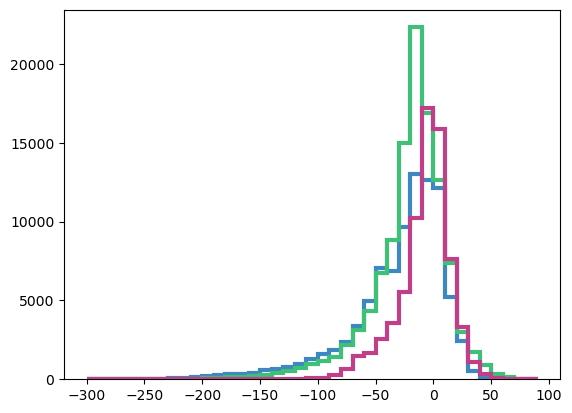

In [10]:
_=plt.hist(ds20['latent'] + ds20['sensible'],ec=c20,histtype='step',lw=3, bins=np.arange(-300,100,10),zorder=3)
_=plt.hist(ds22['latent'] + ds22['sensible'],ec=c22,histtype='step',lw=3, bins=np.arange(-300,100,10),zorder=2)
_=plt.hist(ds23['latent'] + ds23['sensible'],ec=c23,histtype='step',lw=3, bins=np.arange(-300,100,10),zorder=1)

#plt.yscale('log')

## Spatial distribution histograms

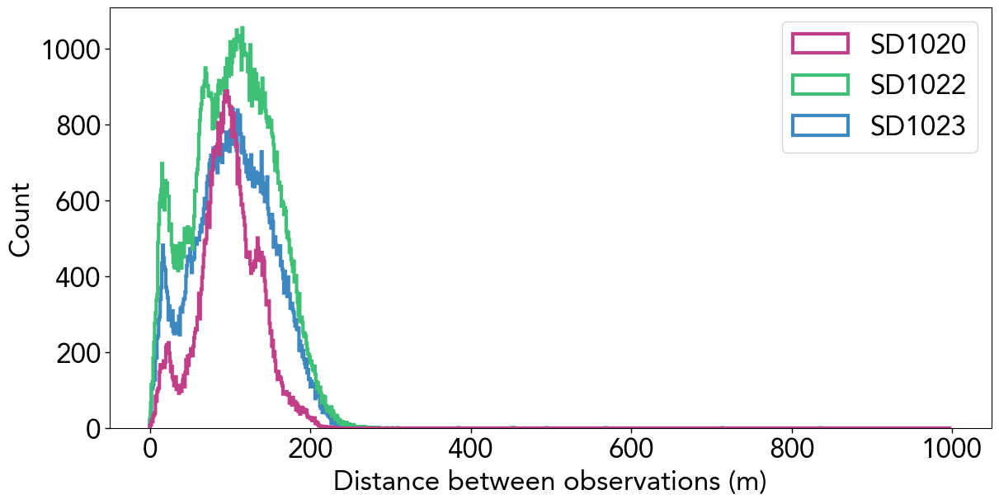

In [21]:
fig,ax = plt.subplots(figsize=(12,6),constrained_layout=True)

_=ax.hist(gsw.distance(ds20.longitude,ds20.latitude)[29510:95630],ec=c20,histtype='step',lw=3, bins=np.arange(0,1000,1),zorder=3, label='SD1020')
_=ax.hist(gsw.distance(ds22.longitude,ds22.latitude)[0:137287],ec=c22,histtype='step',lw=3, bins=np.arange(0,1000,1),zorder=2, label='SD1022')
_=ax.hist(gsw.distance(ds23.longitude,ds23.latitude)[0:100000],ec=c23,histtype='step',lw=3, bins=np.arange(0,1000,1),zorder=1, label='SD1023')

ax.set(ylabel='Count',xlabel='Distance between observations (m)')
ax.legend(loc='upper right')

In [143]:
ds5.drop('trajectory')

<xarray.Dataset>
Dimensions:                         (time: 19126)
Coordinates:
  * time                            (time) datetime64[ns] 2019-01-19T04:00:00...
Data variables: (12/60)
    SOG                             (time) float64 1.778 2.377 ... 1.537 1.254
    COG                             (time) float64 119.0 105.7 ... 56.8 66.56
    HDG                             (time) float64 113.8 106.1 ... 74.0 75.52
    HDG_WING                        (time) float64 112.9 105.3 ... 72.64 73.94
    WING_ANGLE                      (time) float64 -0.82 -0.78 ... -1.36 -1.58
    UWND_MEAN                       (time) float64 13.7 14.52 ... 6.664 5.526
    ...                              ...
    qair                            (time) float64 10.08 9.812 ... 4.291 4.293
    qsea                            (time) float64 10.83 10.86 ... 4.031 4.029
    sensible                        (time) float64 6.003 7.4 16.27 ... 7.6 6.397
    latent                          (time) float64 1.773e-319 ... 1.773e-319
    longitude                       (time) float64 168.5 168.5 ... -51.1 -51.09
    latitude                        (time) float64 -46.68 -46.69 ... -57.66
Attributes: (12/38)
    title:                     Antarctica Circumnavigation Surface Data
    summary:                   This data set was collected from the first Sai...
    ncei_template_version:     NCEI_NetCDF_Trajectory_Template_v2.0
    Conventions:               CF-1.6, ACDD-1.3
    netcdf_version:            4.6.3
    featureType:               trajectory
    ...                        ...
    geospatial_lat_min:        -60.9862208
    geospatial_lat_max:        -46.4277568
    geospatial_lat_units:      degrees_north
    geospatial_lon_min:        -179.9986816
    geospatial_lon_max:        179.9997312
    geospatial_lon_units:      degrees_east

In [59]:
adcp5 = adcp.sel(time=slice(ds5.time[0],ds5.time[-1]))

In [60]:
mt,_,_ = np.intersect1d(ds5.time,adcp5.time,return_indices=True)

full = xr.merge([ds5.sel(time=mt).drop('trajectory'),adcp5.reset_coords().sel(time=mt)],compat='override')

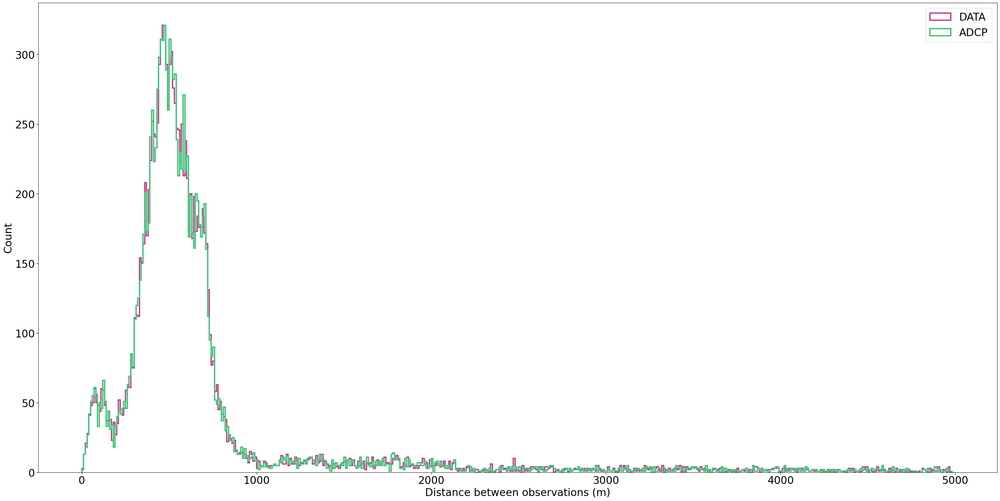

In [63]:
fig,ax = plt.subplots(figsize=(32,16),constrained_layout=True)

_=ax.hist(gsw.distance(ds5.sel(time=mt).longitude,ds5.sel(time=mt).latitude),ec=c20,histtype='step',lw=3, bins=np.arange(0,5000,10),zorder=3, label='DATA')
_=ax.hist(gsw.distance(adcp5.sel(time=mt).longitude,adcp5.sel(time=mt).latitude),ec=c22,histtype='step',lw=3, bins=np.arange(0,5000,10),zorder=3, label='ADCP')
#_=ax.hist(gsw.distance(full.longitude,full.latitude),ec=c23,histtype='step',lw=3, bins=np.arange(0,5000,10),zorder=3, label='MERGED')

ax.set(ylabel='Count',xlabel='Distance between observations (m)')
ax.legend(loc='upper right')

In [128]:
adcp5 = adcp.sel(time=slice(ds5.time[0].values,ds5.time[-1].values))

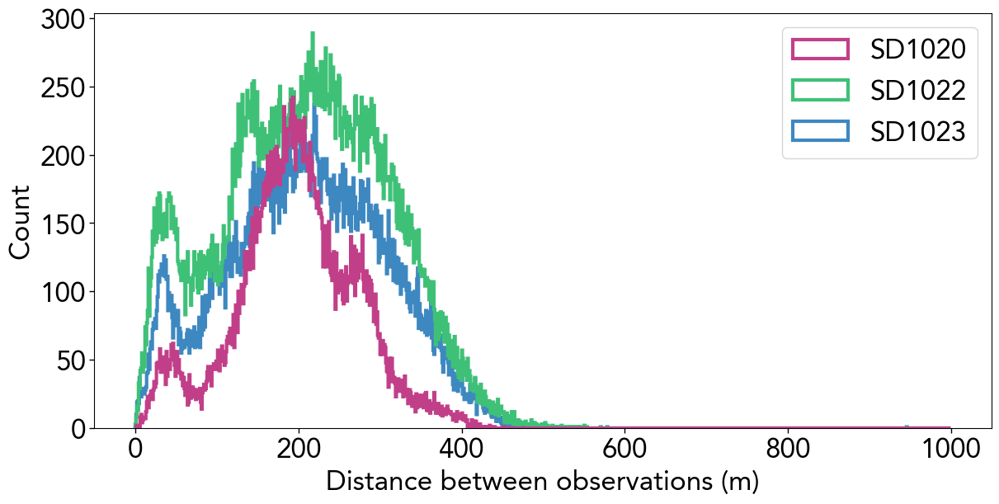

In [22]:
fig,ax = plt.subplots(figsize=(12,6),constrained_layout=True)

_=ax.hist(gsw.distance(ds20.longitude[::2],ds20.latitude[::2])[int(29510/2):int(95630/2)],ec=c20,histtype='step',lw=3, bins=np.arange(0,1000,1),zorder=3, label='SD1020')
_=ax.hist(gsw.distance(ds22.longitude[::2],ds22.latitude[::2])[0:int(137287/2)],ec=c22,histtype='step',lw=3, bins=np.arange(0,1000,1),zorder=2, label='SD1022')
_=ax.hist(gsw.distance(ds23.longitude[::2],ds23.latitude[::2])[0:int(100000/2)],ec=c23,histtype='step',lw=3, bins=np.arange(0,1000,1),zorder=1, label='SD1023')

ax.set(ylabel='Count',xlabel='Distance between observations (m)')
ax.legend(loc='upper right')

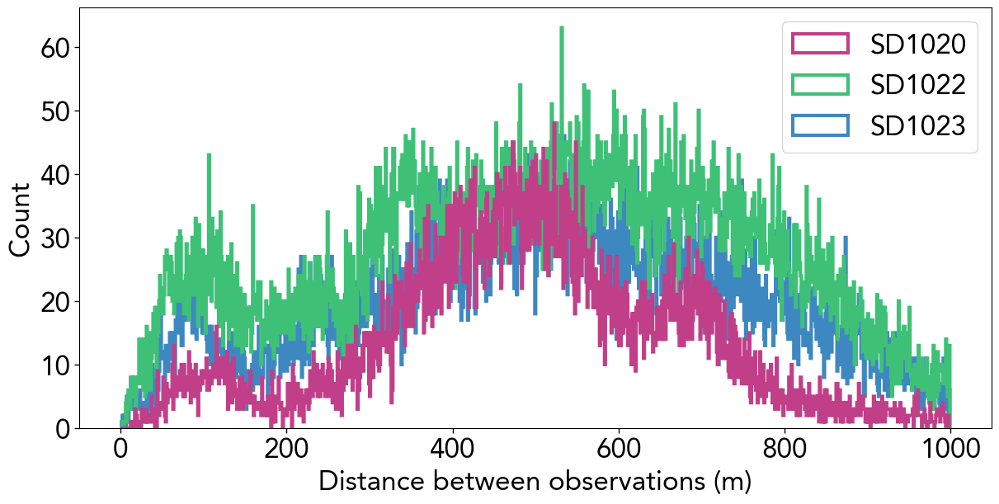

In [24]:
fig,ax = plt.subplots(figsize=(12,6),constrained_layout=True)

_=ax.hist(gsw.distance(ds20.longitude[::5],ds20.latitude[::5])[int(29510/5):int(95630/5)],ec=c20,histtype='step',lw=3, bins=np.arange(0,1000,1),zorder=3, label='SD1020')
_=ax.hist(gsw.distance(ds22.longitude[::5],ds22.latitude[::5])[0:int(137287/5)],ec=c22,histtype='step',lw=3, bins=np.arange(0,1000,1),zorder=2, label='SD1022')
_=ax.hist(gsw.distance(ds23.longitude[::5],ds23.latitude[::5])[0:int(100000/5)],ec=c23,histtype='step',lw=3, bins=np.arange(0,1000,1),zorder=1, label='SD1023')

ax.set(ylabel='Count',xlabel='Distance between observations (m)')
ax.legend(loc='upper right')

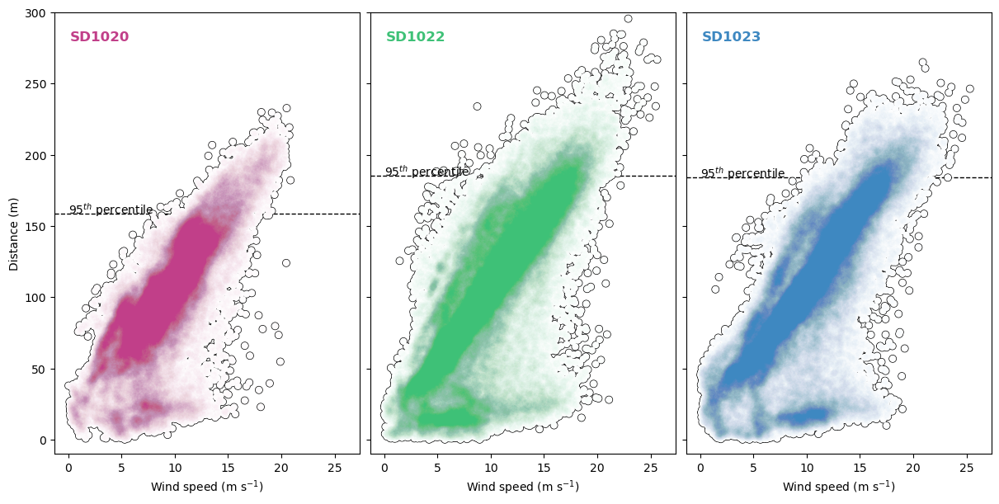

In [36]:
fig,ax = plt.subplots(1,3,figsize=(12,6),constrained_layout=True, sharex=True, sharey=True)

for axs,ds,x1,x2,c,t in zip(ax,[ds20,ds22,ds23],[29510,0,0],[95630,137287,100000],[c20,c22,c23],['SD1020','SD1022','SD1023']):
    axs.scatter(ds['wind_speed'][x1:x2],gsw.distance(ds.longitude,ds.latitude)[x1:x2],fc='None', ec='k',zorder=2)
    axs.scatter(ds['wind_speed'][x1:x2],gsw.distance(ds.longitude,ds.latitude)[x1:x2],fc='w', ec='None',zorder=3)
    axs.scatter(ds['wind_speed'][x1:x2],gsw.distance(ds.longitude,ds.latitude)[x1:x2],fc=c, ec='None',alpha=0.01,zorder=4)
    axs.set(ylim=(-10,300),xlabel="Wind speed (m s$^{-1}$)", ylabel="Distance (m)" if x1 != 0 else "")
    axs.set_title(t,loc='left',x=0.05,y=0.92,fontweight='bold',c=c)
    axs.axhline(np.nanpercentile(gsw.distance(ds.longitude,ds.latitude)[x1:x2],95),c='k',ls='--',lw=1,zorder=1)
    axs.text(-0.5,np.nanpercentile(gsw.distance(ds.longitude,ds.latitude)[x1:x2],95),'95$^{th}$ percentile')

In [11]:
def calc_dens(ds):
    ds['SA'] = gsw.SA_from_SP(ds['SAL_RBR_MEAN'],0,ds['longitude'],ds['latitude'])
    ds['CT'] = gsw.CT_from_t(ds['SA'],ds['TEMP_CTD_RBR_MEAN'],0)
    ds['rho'] = gsw.rho(ds['SA'],ds['CT'],0)
    return ds

In [12]:
ds20 = calc_dens(ds20)
ds22 = calc_dens(ds22)
ds23 = calc_dens(ds23)

## Temporal autocorrelation

In [ ]:
# ds20 = ds20.resample(time='1min').mean('time')

In [20]:
import statsmodels.api as sm

In [250]:
groups = ds20.isel(time=slice(29510,95630)).interpolate_na('time').groupby("time.dayofyear").groups

In [21]:
def calc_and_plot_acv(ax,var,tw,c,shift=0):
    
    x = ds20[var].isel(time=slice(29510,95630)).interpolate_na('time').values
    msk = np.isfinite(x)
    x = x[msk]
    acf = []
    #calculate autocorrelations
    for i in range(int(len(x)/tw)):
        ac = sm.tsa.acf(x[tw*i +shift: tw*(i+1)+1+shift],nlags=tw, missing='conservative')
        ax.plot(ac,c=c,alpha=0.05,zorder=2)
        acf.append(ac)
    return acf

In [252]:
def calc_and_plot_acv(ax,var,tw,c,shift=0):
    
    groups = ds20.isel(time=slice(29510,95630)).interpolate_na('time').groupby("time.dayofyear").groups
    
    
    x = ds20[var].isel(time=slice(29510,95630)).interpolate_na('time').values
    # msk = np.isfinite(x)
    # x = x[msk]
    acf = []
    #calculate autocorrelations
    for g in groups.values:
        ac = sm.tsa.acf(x[g],nlags=tw, missing='conservative')
        ax.plot(ac,c=c,alpha=0.1,zorder=2)
        acf.append(ac)

In [ ]:
groups.values()

In [22]:
ds20['sal'] = ds20['SAL_RBR_MEAN'].copy()#.rolling(time=5,center=True).median('time')

In [23]:
ds20['sal'] = ds20['sal'].where(ds20['sal'] > 33.5)

In [24]:
air_T = ds20['TEMP_AIR_MEAN']

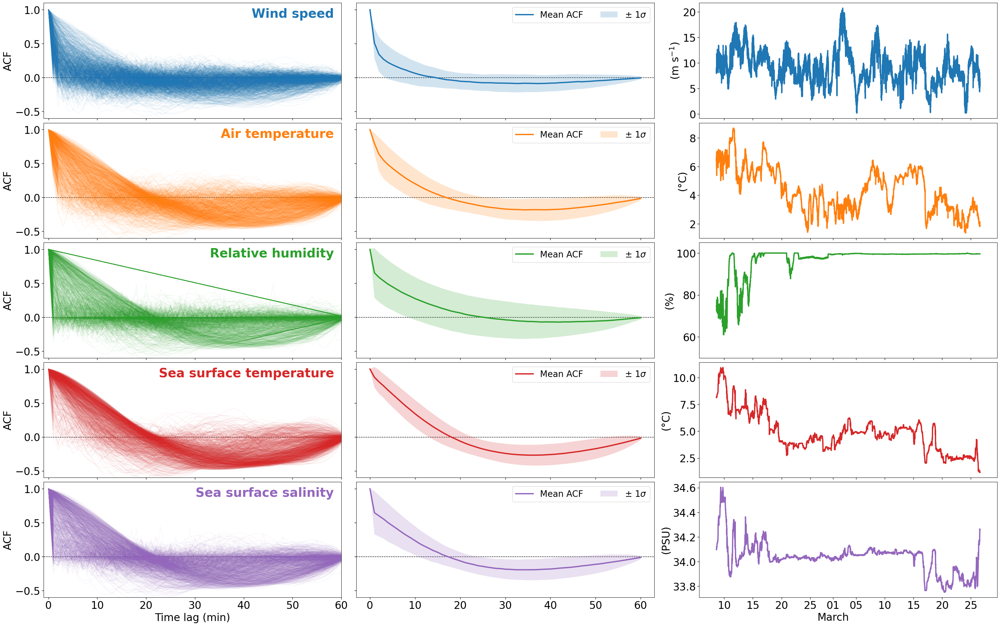

In [270]:
variables = ['wind_speed','TEMP_AIR_MEAN','RH_MEAN','TEMP_CTD_RBR_MEAN','SAL_RBR_MEAN']
titles = ['Wind speed','Air temperature','Relative humidity','Sea surface temperature','Sea surface salinity']
units = ["m s$^{-1}$", "°C", "%", "°C", "PSU"]
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

fig,ax = plt.subplots(int(len(variables)),3,constrained_layout=True,figsize=(32,4*len(variables)),sharex='col')

acf = []
tw=60*1

for axs,var,t,c in zip(ax.T[0],variables,titles,colors):
    acf.append(calc_and_plot_acv(axs,var,tw,c,shift=0))
    axs.set(xlabel='Time lag (min)' if "SAL" in var else "",xlim=(-1,tw),ylabel="ACF")
    axs.set_title(t,loc='right',x=0.975,y=0.85,c=c,fontweight='bold')
    axs.axhline(0,ls='--',zorder=1,c='k',lw=1)
    axs.set(ylim=(-0.6,1.1))

for axs,i,l,c in zip(ax.T[1],range(5),titles,colors):
    axs.plot(np.nanmean(acf[i][:-1],axis=0),label=f"Mean ACF",lw=3,c=c,zorder=2)
    axs.fill_between(np.arange(0,tw+1,1),np.nanmean(acf[i][:-1],axis=0)-np.nanstd(acf[i][:-1],axis=0),np.nanmean(acf[i][:-1],axis=0)+np.nanstd(acf[i][:-1],axis=0),label=r"$\pm$ 1$\sigma$",lw=3,fc=c,ec='None',alpha=0.2,zorder=2)
    axs.axhline(0,lw=1,ls='--',zorder=1,c='k')
    axs.legend(ncols=2,fontsize='small')
    axs.set(ylim=(-0.6,1.1),yticklabels=[])

variables[-1] = 'sal'

for axs,var,t,u,c in zip(ax.T[2],variables,titles,units,colors):
    ds20[var].isel(time=slice(29510,95630)).rolling(time=3,center=True).median('time').plot(ax=axs,c=c,lw=3)    
    axs.set(ylabel=f"({u})",title='',xlabel="")
    #axs.set_title(t,loc='left',x=0.01,y=0.02)

ax.T[2][2].set(ylim=(50,105))

my_funcs.fix_xticks([axs],ds20.isel(time=slice(29510,95630)))

[(-0.6, 1.1),

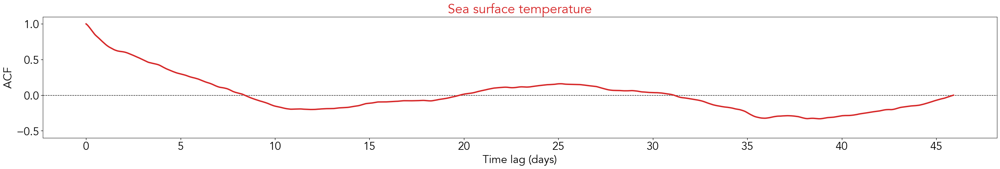

In [57]:
fig,ax = plt.subplots(figsize=(30,5),constrained_layout=True)

x = ds20["TEMP_CTD_RBR_MEAN"].isel(time=slice(29510,95630)).interpolate_na('time').values
msk = np.isfinite(x)
x = x[msk]

ax.plot(np.arange(0,len(x),1)/1440,sm.tsa.acf(x, nlags=len(x) , missing='conservative'),c=colors[3],lw=3)
ax.set(xlabel='Time lag (days)',ylabel="ACF")
ax.set_title("Sea surface temperature",c=colors[3],fontweight='bold')
ax.axhline(0,ls='--',zorder=1,c='k',lw=1)
ax.set(ylim=(-0.6,1.1),xticks=np.arange(0,50,5))

One of the things you can do with autocovariances is to compute a decorrelation time scale, and that calculation depends on the time interval over which you integrate.  If you have the patience, it would be interesting to look at decorrelation time as a function of time window duration.  (You can check my course notes for SIOC 221B for this, but it might be easier if we just plan to discuss in person.)

Text(0.5, 0.98, 'Sea surface temperature')

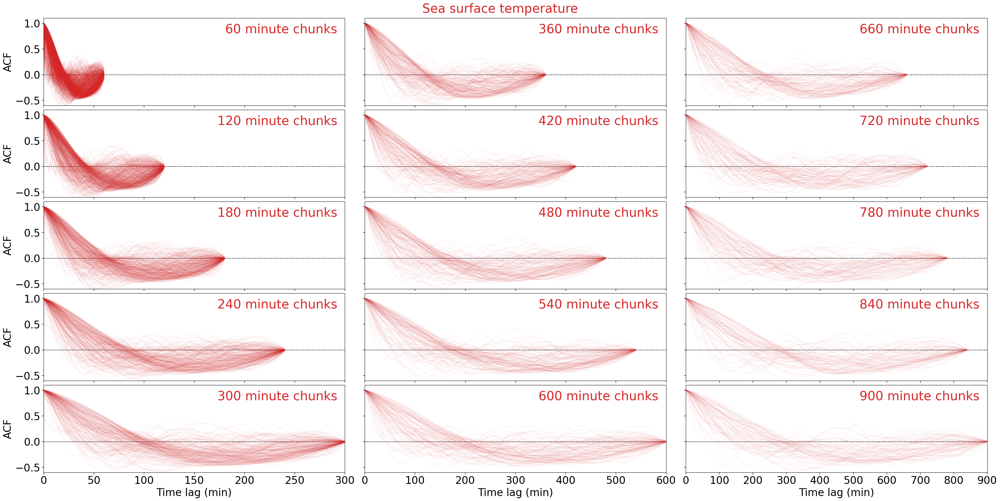

In [339]:
variables = ['wind_speed','TEMP_AIR_MEAN','RH_MEAN','TEMP_CTD_RBR_MEAN','SAL_RBR_MEAN']
titles = ['Wind speed','Air temperature','Relative humidity','Sea surface temperature','Sea surface salinity']
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

fig,ax = plt.subplots(int(len(variables)),3,constrained_layout=True,figsize=(32,16),sharex='col',sharey='row')

acf = []
tw=60*1

for i,axs in enumerate(ax.T.flatten()):
    acf.append(calc_and_plot_acv(axs,"TEMP_CTD_RBR_MEAN",tw*(i+1),colors[3],shift=30))
    axs.set(xlabel='Time lag (min)' if i in [4,9,14] else "",xlim=(-1,tw*(i+1)),ylabel="ACF" if i < 5 else "")
    axs.set_title(f"{60*(i+1)} minute chunks",loc='right',x=0.975,y=0.8,c=colors[3],fontweight='normal')
    axs.axhline(0,ls='--',zorder=1,c='k',lw=1)
    axs.set(ylim=(-0.6,1.1),xlim=(0,60*(i+1)))
    
fig.suptitle("Sea surface temperature",c=colors[3],fontweight='normal')

In [56]:
def calc_and_plot_acv_test(ax,var,tw,c,n,shift=0):
    
    x = ds20[var].isel(time=slice(29510,95630)).interpolate_na('time').values
    msk = np.isfinite(x)
    x = x[msk]
    acf = []
    #calculate autocorrelations
    for i in range(n):
        ac = sm.tsa.acf(x[i: tw+i+1],nlags=tw, missing='conservative')
        ax.plot(ac,c=c,alpha=0.01,zorder=2)
        acf.append(ac)
    return acf

Text(0.5, 0.98, 'Sea surface temperature')

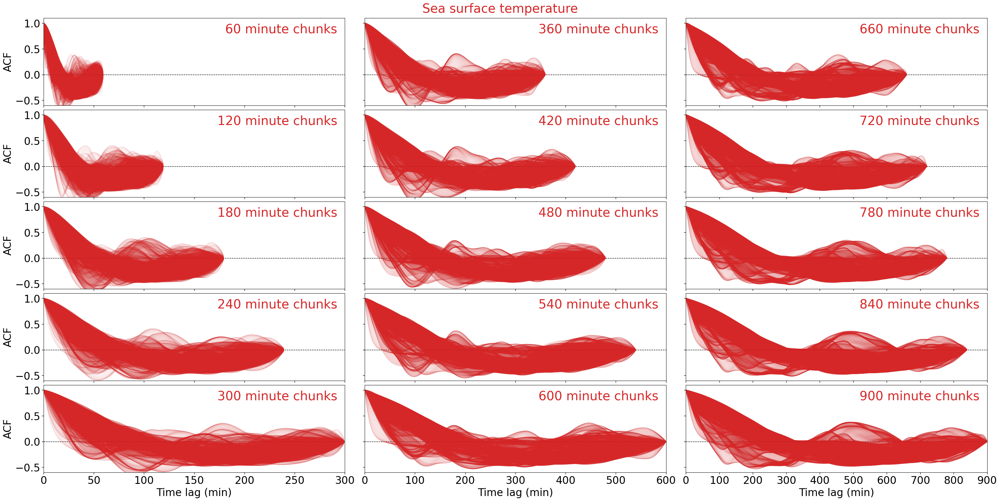

In [27]:
variables = ['wind_speed','TEMP_AIR_MEAN','RH_MEAN','TEMP_CTD_RBR_MEAN','SAL_RBR_MEAN']
titles = ['Wind speed','Air temperature','Relative humidity','Sea surface temperature','Sea surface salinity']
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

fig,ax = plt.subplots(int(len(variables)),3,constrained_layout=True,figsize=(32,16),sharex='col',sharey='row')

acf = []
tw=60*1

for i,axs in enumerate(ax.T.flatten()):
    acf.append(calc_and_plot_acv_test(axs,"TEMP_CTD_RBR_MEAN",tw*(i+1),colors[3],1000,shift=30))
    axs.set(xlabel='Time lag (min)' if i in [4,9,14] else "",xlim=(-1,tw*(i+1)),ylabel="ACF" if i < 5 else "")
    axs.set_title(f"{60*(i+1)} minute chunks",loc='right',x=0.975,y=0.8,c=colors[3],fontweight='normal')
    axs.axhline(0,ls='--',zorder=1,c='k',lw=1)
    axs.set(ylim=(-0.6,1.1),xlim=(0,60*(i+1)))
    
fig.suptitle("Sea surface temperature",c=colors[3],fontweight='normal')

Text(0.5, 0.98, 'Wind speed')

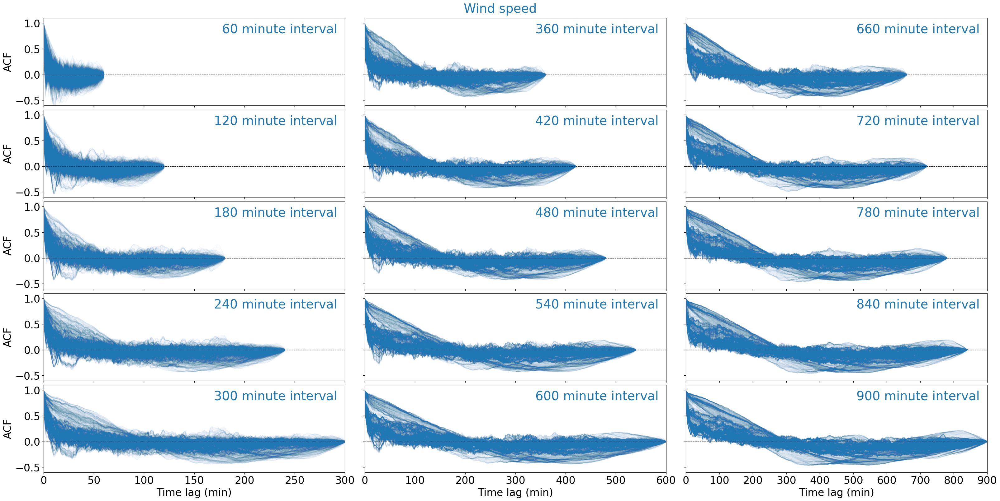

In [58]:
variables = ['wind_speed','TEMP_AIR_MEAN','RH_MEAN','TEMP_CTD_RBR_MEAN','SAL_RBR_MEAN']
titles = ['Wind speed','Air temperature','Relative humidity','Sea surface temperature','Sea surface salinity']
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

fig,ax = plt.subplots(int(len(variables)),3,constrained_layout=True,figsize=(32,16),sharex='col',sharey='row')

acf = []
tw=60*1

for i,axs in enumerate(ax.T.flatten()):
    acf.append(calc_and_plot_acv_test(axs,"wind_speed",tw*(i+1),colors[0],1440*3,shift=0))
    axs.set(xlabel='Time lag (min)' if i in [4,9,14] else "",xlim=(-1,tw*(i+1)),ylabel="ACF" if i < 5 else "")
    axs.set_title(f"{60*(i+1)} minute interval",loc='right',x=0.975,y=0.8,c=colors[0],fontweight='normal')
    axs.axhline(0,ls='--',zorder=1,c='k',lw=1)
    axs.set(ylim=(-0.6,1.1),xlim=(0,60*(i+1)))
    
fig.suptitle("Wind speed",c=colors[0],fontweight='normal')

1000

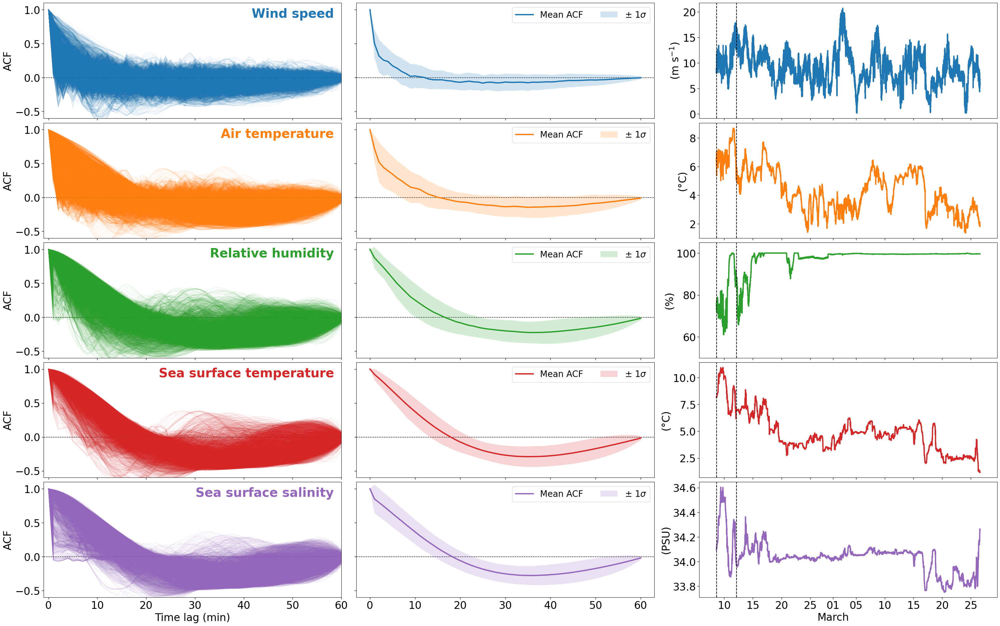

In [33]:
variables = ['wind_speed','TEMP_AIR_MEAN','RH_MEAN','TEMP_CTD_RBR_MEAN','SAL_RBR_MEAN']
titles = ['Wind speed','Air temperature','Relative humidity','Sea surface temperature','Sea surface salinity']
units = ["m s$^{-1}$", "°C", "%", "°C", "PSU"]
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

fig,ax = plt.subplots(int(len(variables)),3,constrained_layout=True,figsize=(32,4*len(variables)),sharex='col')

acf = []
tw=60*1

for axs,var,t,c in zip(ax.T[0],variables,titles,colors):
    acf.append(calc_and_plot_acv_test(axs,var,tw,c,5000,shift=0))
    axs.set(xlabel='Time lag (min)' if "SAL" in var else "",xlim=(-1,tw),ylabel="ACF")
    axs.set_title(t,loc='right',x=0.975,y=0.85,c=c,fontweight='bold')
    axs.axhline(0,ls='--',zorder=1,c='k',lw=1)
    axs.set(ylim=(-0.6,1.1))

for axs,i,l,c in zip(ax.T[1],range(5),titles,colors):
    axs.plot(np.nanmean(acf[i][:-1],axis=0),label=f"Mean ACF",lw=3,c=c,zorder=2)
    axs.fill_between(np.arange(0,tw+1,1),np.nanmean(acf[i][:-1],axis=0)-np.nanstd(acf[i][:-1],axis=0),np.nanmean(acf[i][:-1],axis=0)+np.nanstd(acf[i][:-1],axis=0),label=r"$\pm$ 1$\sigma$",lw=3,fc=c,ec='None',alpha=0.2,zorder=2)
    axs.axhline(0,lw=1,ls='--',zorder=1,c='k')
    axs.legend(ncols=2,fontsize='small')
    axs.set(ylim=(-0.6,1.1),yticklabels=[])

variables[-1] = 'sal'

for axs,var,t,u,c in zip(ax.T[2],variables,titles,units,colors):
    ds20[var].isel(time=slice(29510,95630)).rolling(time=3,center=True).median('time').plot(ax=axs,c=c,lw=3)    
    axs.axvline(ds20["time"].isel(time=29510).values,c='k',ls='--')
    axs.axvline(ds20["time"].isel(time=29510+5000).values,c='k',ls='--')
    axs.set(ylabel=f"({u})",title='',xlabel="")
    #axs.set_title(t,loc='left',x=0.01,y=0.02)

ax.T[2][2].set(ylim=(50,105))

my_funcs.fix_xticks([axs],ds20.isel(time=slice(29510,95630)))

In [27]:
x = ds20["TEMP_CTD_RBR_MEAN"].isel(time=slice(29510,95630)).interpolate_na('time').values
msk = np.isfinite(x)
x = x[msk]


for i in range(int(len(x)/60)):
    fig,ax = plt.subplots()
    ax.plot(x[60*i : 60*(i+1)+1])
    ax.set(ylim=(0,12))
    plt.savefig(f"../figures/{i}.png")
    plt.close()

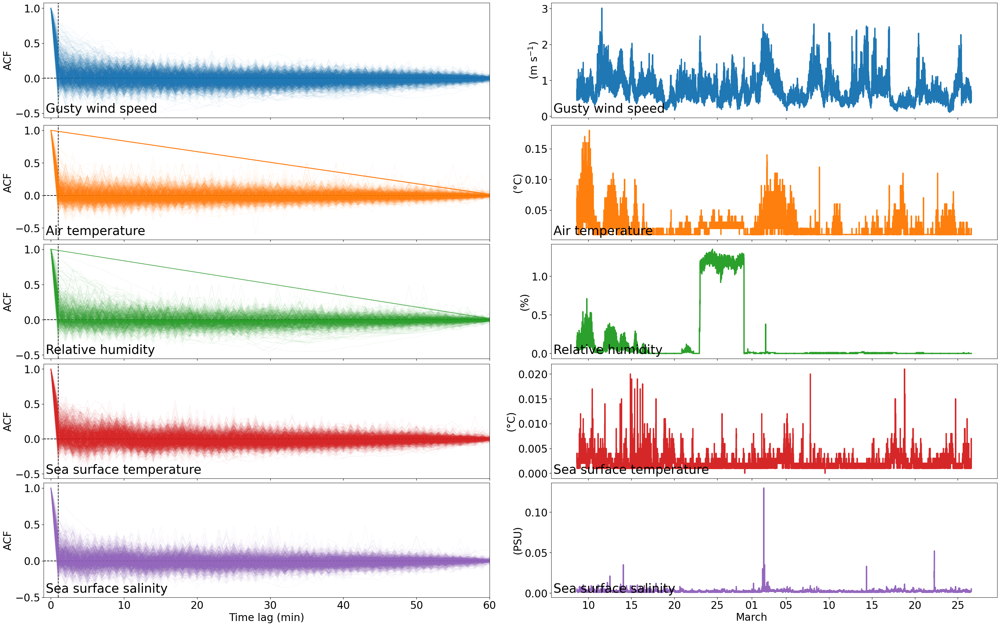

In [281]:
vars = ['GUST_WND_STDDEV','TEMP_AIR_STDDEV','RH_STDDEV','TEMP_CTD_RBR_STDDEV','SAL_RBR_STDDEV']
titles = ['Gusty wind speed','Air temperature','Relative humidity','Sea surface temperature','Sea surface salinity']

fig,ax = plt.subplots(int(len(vars)),2,constrained_layout=True,figsize=(32,4*len(vars)),sharex='col')

acf = []

for i, (axs, var, t) in enumerate(zip(ax.T[0], vars, titles)):
    acf.append(calc_and_plot_acv(axs,var,60,colors[i]))
    axs.set(xlabel='Time lag (min)' if "SAL" in var else "",xlim=(-1,60),ylabel="ACF")
    axs.set_title(t,loc='left',x=0.005,y=0.02)
    axs.axhline(0,ls='--',zorder=1,c='k')
    axs.axvline(1,ls='--',zorder=1,c='k')

#vars = ['wind_speed','TEMP_AIR_MEAN','RH_MEAN','TEMP_CTD_RBR_MEAN','sal']
units = ["m s$^{-1}$", "°C", "%", "°C", "PSU"]

for i,(axs,var,t,u) in enumerate(zip(ax.T[1],vars,titles,units)):
    ds20[var].isel(time=slice(29510,95630)).rolling(time=3,center=True).median('time').plot(ax=axs,c=colors[i],lw=3)    
    axs.set(ylabel=f"({u})",title='',xlabel="")
    axs.set_title(t,loc='left',x=0.005,y=0.02)

#ax.T[1][2].set(ylim=(50,105))

my_funcs.fix_xticks([axs],ds20.isel(time=slice(29510,95630)))

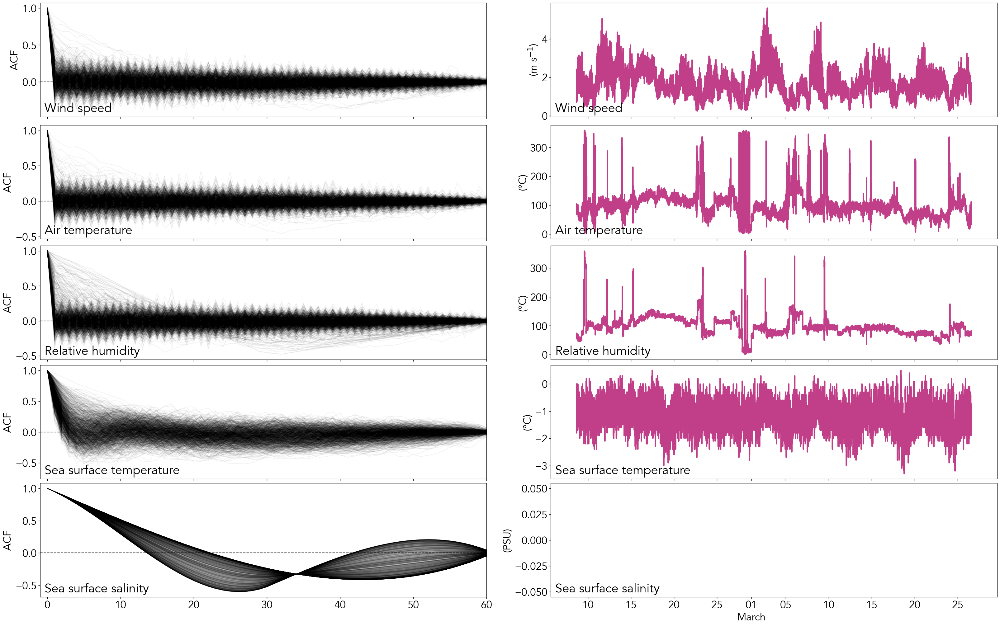

In [32]:
variables = ['SOG','COG','HDG','WING_ANGLE','WAVE_SIGNIFICANT_HEIGHT']
titles = ['Wind speed','Air temperature','Relative humidity','Sea surface temperature','Sea surface salinity']

fig,ax = plt.subplots(int(len(variables)),2,constrained_layout=True,figsize=(32,4*len(variables)),sharex='col')

acf = []

for axs,var,t in zip(ax.T[0],variables,titles):
    acf.append(calc_and_plot_acv(axs,var))
    axs.set(xlabel='Time lag (min)' if "SAL" in var else "",xlim=(-1,60),ylabel="ACF")
    axs.set_title(t,loc='left',x=0.01,y=0.02)
    axs.axhline(0,ls='--',zorder=1,c='k')

#variables = ['wind_speed','TEMP_AIR_MEAN','RH_MEAN','TEMP_CTD_RBR_MEAN','sal']
units = ["m s$^{-1}$", "°C", "°C", "°C", "PSU"]

for axs,var,t,u in zip(ax.T[1],variables,titles,units):
    ds20[var].isel(time=slice(29510,95630)).rolling(time=3,center=True).median('time').plot(ax=axs,c=c20,lw=3)    
    axs.set(ylabel=f"({u})",title='',xlabel="")
    axs.set_title(t,loc='left',x=0.01,y=0.02)

#ax.T[1][2].set(ylim=(50,105))

my_funcs.fix_xticks([axs],ds20.isel(time=slice(29510,95630)))

In [ ]:
sm.tsa.acf(

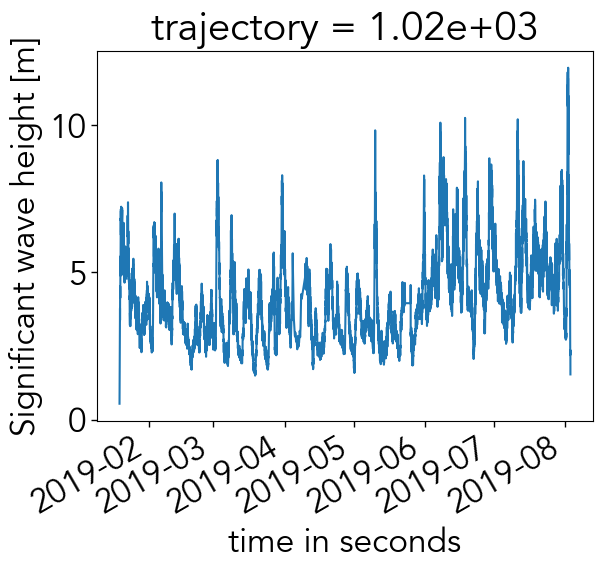

In [35]:
ds20['WAVE_SIGNIFICANT_HEIGHT'].interpolate_na('time').plot()

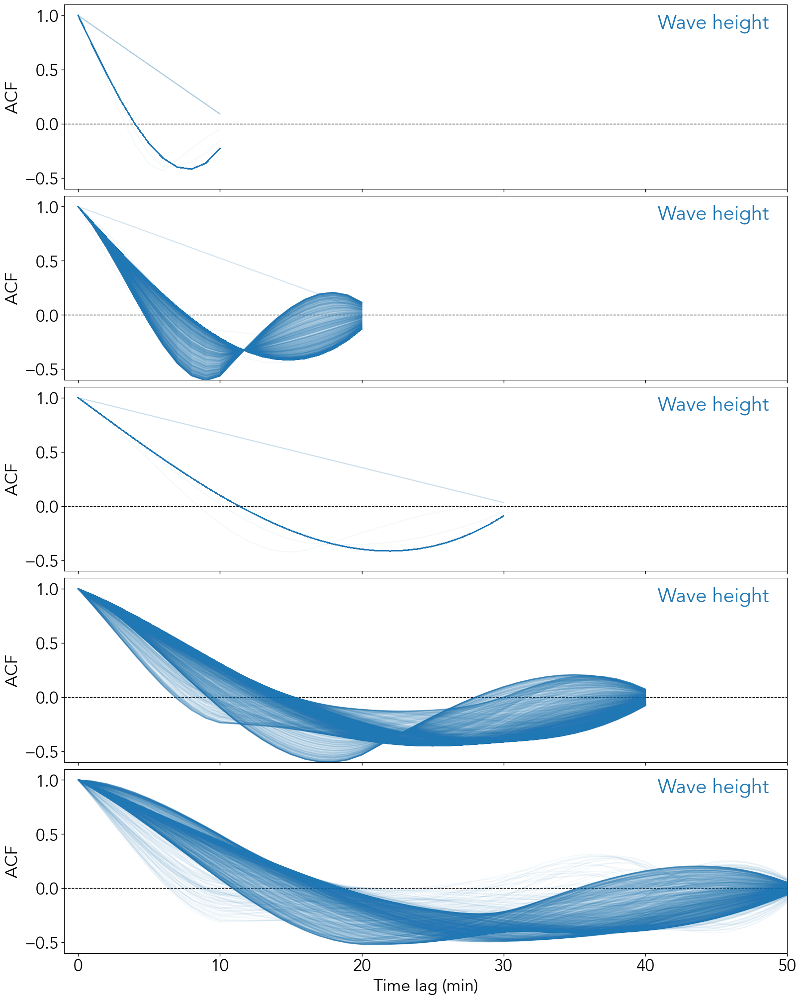

In [129]:
fig,ax = plt.subplots(int(len(variables)),1,constrained_layout=True,figsize=(16,4*len(variables)),sharex='col')

acf = []
tw=10*1

for i,axs in enumerate(ax.T):
    acf.append(calc_and_plot_acv(axs,"WAVE_SIGNIFICANT_HEIGHT",tw*(i+1),colors[0]))
    axs.set(xlabel='Time lag (min)' if i == 4 else "",xlim=(-1,tw*(i+1)),ylabel="ACF")
    axs.set_title("Wave height",loc='right',x=0.975,y=0.85,c=colors[0],fontweight='bold')
    axs.axhline(0,ls='--',zorder=1,c='k',lw=1)
    axs.set(ylim=(-0.6,1.1))

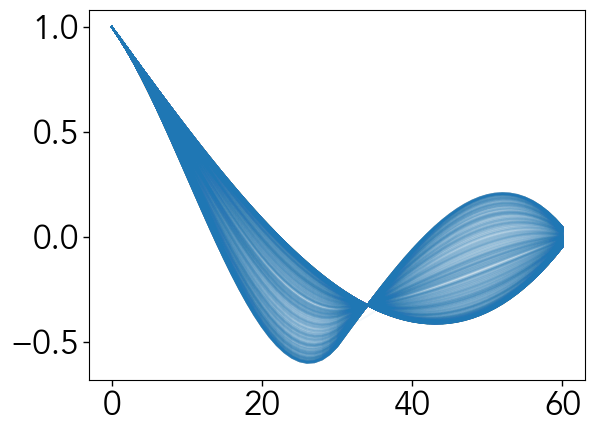

In [142]:
fig,ax=plt.subplots()
_=calc_and_plot_acv(ax,"WAVE_SIGNIFICANT_HEIGHT",60,colors[0])

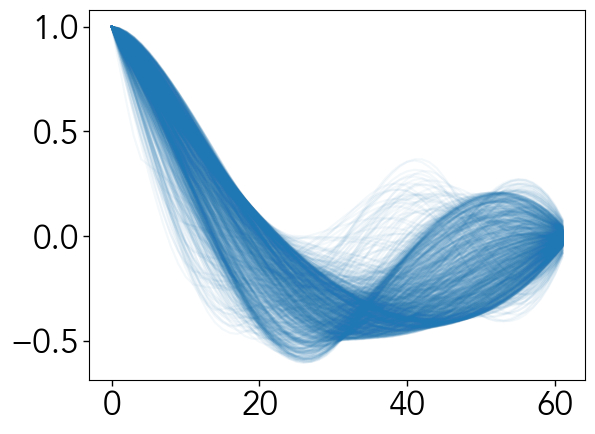

In [143]:
fig,ax=plt.subplots()
_=calc_and_plot_acv(ax,"WAVE_SIGNIFICANT_HEIGHT",61,colors[0])

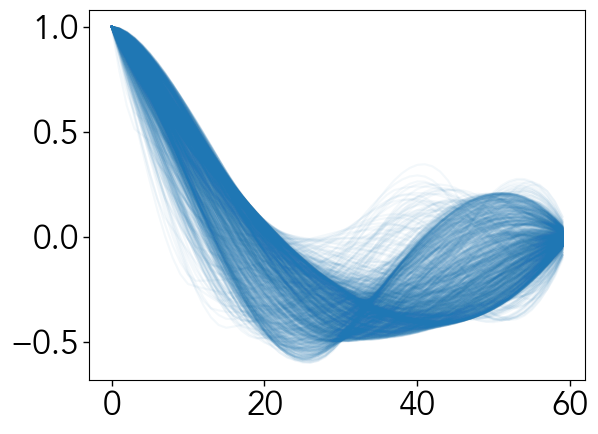

In [144]:
fig,ax=plt.subplots()
_=calc_and_plot_acv(ax,"WAVE_SIGNIFICANT_HEIGHT",59,colors[0])

## ADCP Stuff 

In [157]:
adcp20 = adcp20.squeeze()

### Quick look

In [173]:
adcp20 = adcp20.swap_dims({'obs':'time'})

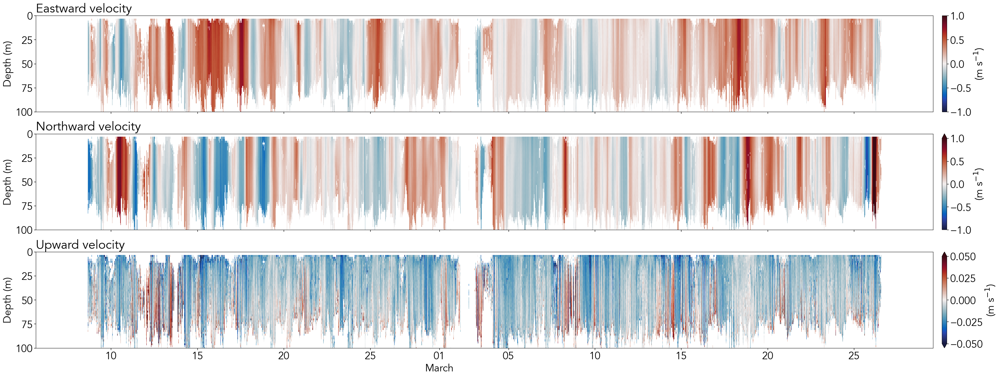

In [182]:
fig,ax = plt.subplots(3,1,figsize=(32,12),constrained_layout=True, sharex=True)

variables = ["vel_east","vel_north","vel_up"]
vmins = [-1,-1,-0.05]
vmaxs = [1,1,0.05]
titles = ['Eastward velocity', 'Northward velocity', 'Upward velocity']

for axs,var,vmin,vmax,title in zip(ax,variables,vmins,vmaxs,titles):
    adcp20[var].where(adcp20["percent_good"]>85).sel(time=slice(times[0],times[1])).plot(ax=axs,y="cell_depth",vmin=vmin,vmax=vmax,cmap="cmo.balance",ylim=(100,0),cbar_kwargs={'pad':0.01,'label':"(m s$^{-1}$)"})
    axs.set(xlabel='',ylabel="Depth (m)",title="")
    axs.set_title(title,loc='left')

my_funcs.fix_xticks(ax,adcp20.sel(time=slice(times[0],times[1])))

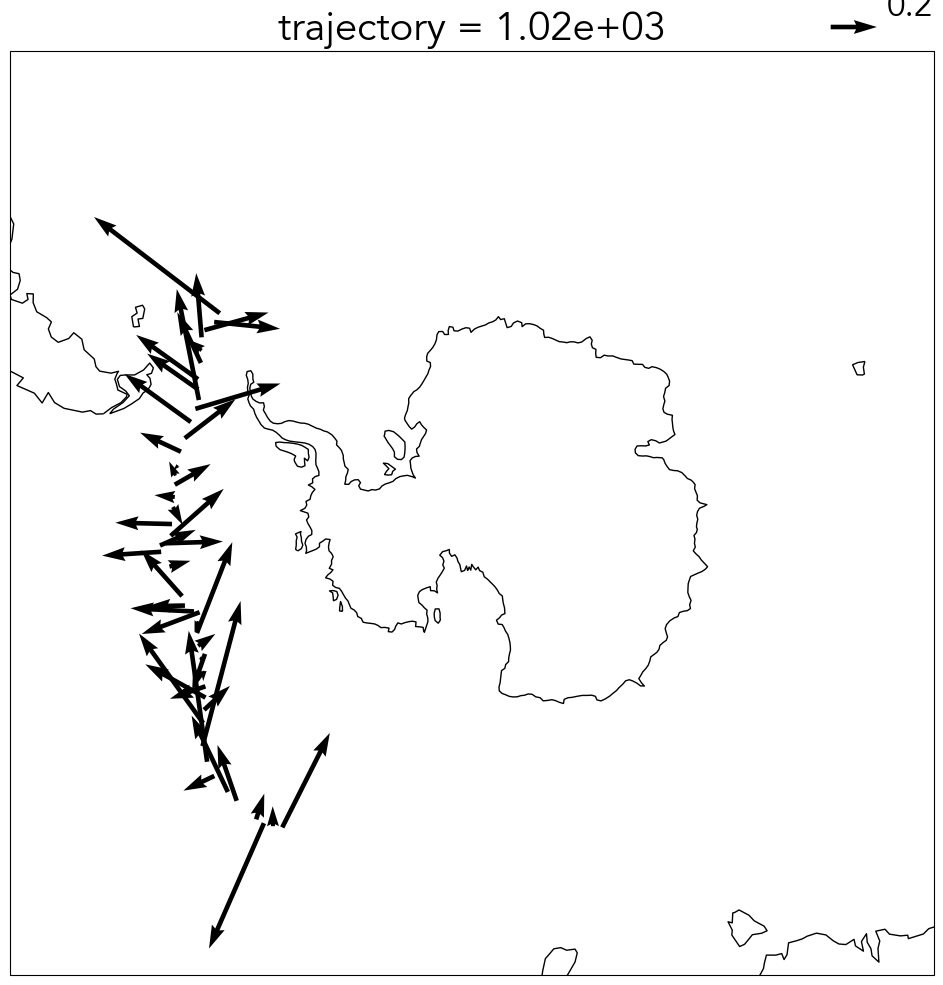

In [215]:
fig, ax = plt.subplots(figsize=(12, 12), subplot_kw={"projection": ccrs.SouthPolarStereo()})

(adcp20.where(adcp20["percent_good"] > 85)
       .sel(time=slice(times[0], times[1]))
       .resample(time="1D")
       .mean('time')
       .sel(cell_depth=slice(0, 20))
       .mean("cell_depth")
       .plot.quiver(x='nav_start_longitude', y="nav_start_latitude", u="vel_east", v="vel_north",
                    scale=4, pivot="tail", width=0.005,
                    transform=ccrs.PlateCarree())
)

ax.coastlines()
ax.set_extent([-180, 180, -90, -45], ccrs.PlateCarree())

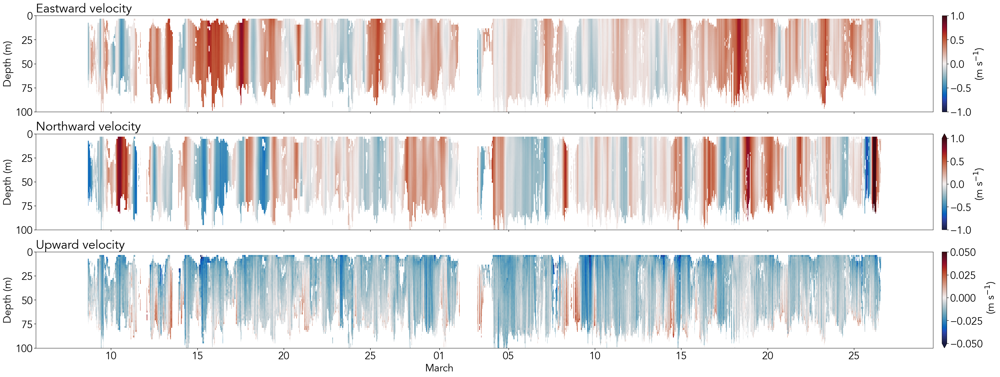

In [226]:
fig,ax = plt.subplots(3,1,figsize=(32,12),constrained_layout=True, sharex=True)

variables = ["vel_east","vel_north","vel_up"]
vmins = [-1,-1,-0.05]
vmaxs = [1,1,0.05]
titles = ['Eastward velocity', 'Northward velocity', 'Upward velocity']

for axs,var,vmin,vmax,title in zip(ax,variables,vmins,vmaxs,titles):
    adcp20[var].where(adcp20["percent_good"]>85).sel(time=slice(times[0],times[1])).rolling(time=6,center=True).mean("time").plot(ax=axs,y="cell_depth",vmin=vmin,vmax=vmax,cmap="cmo.balance",ylim=(100,0),cbar_kwargs={'pad':0.01,'label':"(m s$^{-1}$)"})
    axs.set(xlabel='',ylabel="Depth (m)",title="")
    axs.set_title(title,loc='left')

my_funcs.fix_xticks(ax,adcp20.sel(time=slice(times[0],times[1])))

In [266]:
adcp20.time

<xarray.DataArray 'time' (time: 38105)>
array(['2019-01-19T04:00:00.000000000', '2019-01-19T04:10:00.000000000',
       '2019-01-19T04:20:00.000000000', ..., '2019-08-03T04:10:00.000000000',
       '2019-08-03T04:15:00.000000000', '2019-08-03T04:20:00.000000000'],
      dtype='datetime64[ns]')
Coordinates:
    trajectory  float32 1.02e+03
  * time        (time) datetime64[ns] 2019-01-19T04:00:00 ... 2019-08-03T04:2...
    latitude    (time) float64 ...
    longitude   (time) float64 ...
Attributes:
    long_name:             time
    standard_name:         time
    sampling_description:  always on
    vendor_name:           VectorNav
    model_name:            VN-300
    serial_number:         100035657
    installed_height:      0.34
    calibration_date:      2019-02-13
    installed_date:        2019-02-13
    product_page:          https://www.vectornav.com/products/vn-300

In [268]:
ds5 = ds20.resample(time='5min').mean('time')

In [274]:
ds5 = xr.merge([ds5,ds20.reset_coords()[['latitude','longitude']].resample(time='5min').mean('time')])

In [278]:
ds5 = ds5.set_coords(['latitude','longitude'])

In [279]:
ds5.to_netcdf('../data/sd1020_5min.nc')

In [283]:
mt = np.intersect1d(adcp20.time,ds5.time)

In [291]:
ds = xr.merge([ds5.sel(time=mt),adcp20.sel(time=mt)],compat='override')

In [310]:
ds['distance'] = ('time'), np.insert(gsw.distance(ds.longitude,ds.latitude),0,0)

In [313]:
ds['U'] = np.sqrt(ds['vel_east']**2 + ds['vel_north']**2).mean('cell_depth')

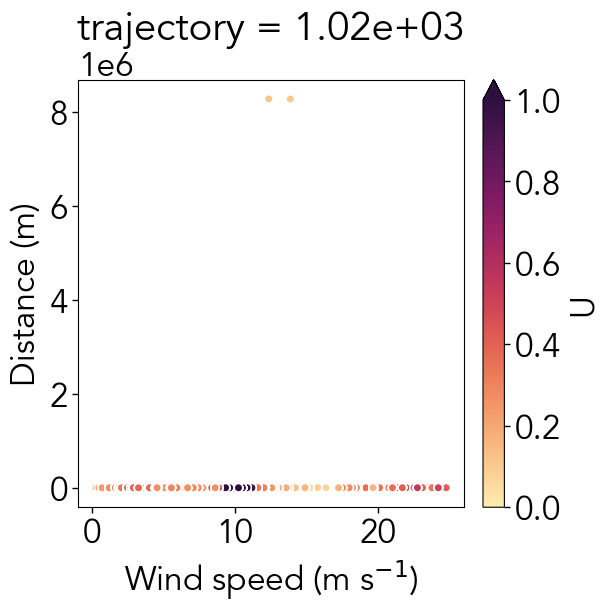

In [317]:
fig,ax = plt.subplots(1,1,figsize=(6,6),constrained_layout=True)

ds.plot.scatter(x='wind_speed',y="distance",hue='U',cmap='cmo.matter',vmin=0,vmax=1)
ax.set(xlabel="Wind speed (m s$^{-1}$)", ylabel="Distance (m)")

plt.show()

In [240]:
sb = xr.open_dataset('/Users/xedhjo/Documents/Projects/QUICCHE/data/sailbuoy/PimPim/full/DATA.nc')

In [241]:
sb

<xarray.Dataset>
Dimensions:      (time: 8846)
Coordinates:
  * time         (time) datetime64[ns] 2023-03-22T05:50:00 ... 2023-05-23T05:...
Data variables: (12/26)
    latitude     (time) float64 ...
    longitude    (time) float64 ...
    ttff         (time) float64 ...
    count        (time) float64 ...
    commands     (time) float64 ...
    tries        (time) float64 ...
    ...           ...
    ssc          (time) float64 ...
    sss          (time) float64 ...
    dcps_flag    (time) float64 ...
    dcps_time    (time) timedelta64[ns] ...
    dcps_speed   (time) float64 ...
    dcps_dir     (time) float64 ...
Attributes: (12/24)
    title:                SB PimPim Datalogger
    summary:              Datalogger output from Sailbuoy PimPim
    conventions:          CF-1.6, ACDD-1.3
    creator_name:         Johan Edholm
    platform:             Uncrewed surface vehicle
    instrument_name:      PimPim
    ...                   ...
    time_coverate_start:  2023-03-22T05:50:00.000000000
    time_coverate_end:    2023-05-23T05:30:00.000000000
    geospatial_lat_min:   -40.014976
    geospatial_lat_max:   -34.137235
    geospatial_lon_min:   14.311086
    geospatial_lon_max:   20.131414

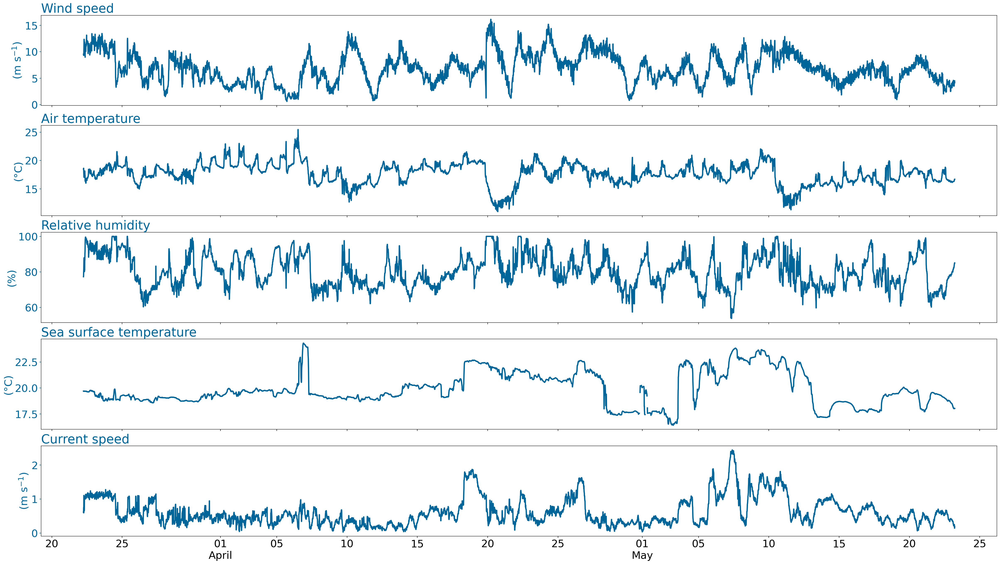

In [248]:
# Create subplots
fig, ax = plt.subplots(5, 1, figsize=(32, 18), constrained_layout=True, sharex=True, dpi=150)

lw = 3  # Line width

# Define variables, labels, and units for left and right y-axes
variables_l = ['wind_speed', 'air_t','rh', "sst", "dcps_speed"]
label_l = ['Wind speed', 'Air temperature','Relative humidity', "Sea surface temperature", "Current speed"]
units_l = ['(m s$^{-1}$)', '(°C)',"(%)", "(°C)", "(m s$^{-1}$)"]

#variables_r = ['BARO_PRES_MEAN', 'RH_MEAN', "SAL_RBR_MEAN", "WAVE_DOMINANT_PERIOD"]
#label_r = ['Barometric pressure', 'Relative humidity', "Sea surface salinity", "Dominant wave period"]
#units_r = ["(hPa)", '(%)', "(PSU)", "(seconds)"]

# Loop through the axes
for axs, lvar, llabel, lunit in zip(ax, variables_l, label_l, units_l):

    # Plot data on left axis
    sb[lvar].rolling(time=3, center=True).median('time').plot(ax=axs, lw=lw, c="#006699", zorder=2)

    axs.set(title='', xlabel='', ylabel=lunit)
    axs.set_title(llabel, loc='left', c="#006699", fontweight='normal')

    # Set colors for left and right axes
    axs.tick_params(axis='y', colors="#006699")
    axs.yaxis.label.set_color("#006699")
    bxs.spines['left'].set_color("#006699")

    # Hide top spine for both axes
    #axs.spines['top'].set_visible(False)
    #bxs.spines['top'].set_visible(False)
    

# Call function to fix x-axis ticks
my_funcs.fix_xticks(ax, sb)

(-1000.0, 1000.0, -0.2, 1.1)

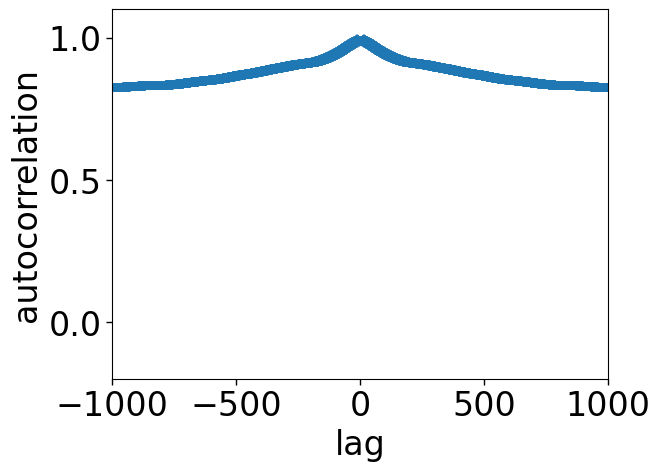

In [344]:
# compute the autocorrelation
Nbig=len(ds5['wind_speed'])
xcov=np.correlate(ds5['wind_speed'],ds5['wind_speed'],mode="full")
plt.plot(range(-Nbig+1,Nbig),xcov/xcov[Nbig-1],marker='x')
plt.xlabel("lag")
plt.ylabel("autocorrelation")
plt.axis([-1000,1000,-.2,1.1])

In [44]:
5*12*24

1440

In [49]:
(ds5['TEMP_CTD_RBR_MEAN']-ds5['TEMP_CTD_RBR_MEAN'].rolling(time=int(4),center=True).mean('time')).var()

<xarray.DataArray 'TEMP_CTD_RBR_MEAN' ()>
array(0.00034432)
Coordinates:
    trajectory  float32 1.02e+03

In [50]:
(ds5['TEMP_CTD_RBR_MEAN']-ds5['TEMP_CTD_RBR_MEAN'].rolling(time=int(4),center=True).mean('time')).std()

<xarray.DataArray 'TEMP_CTD_RBR_MEAN' ()>
array(0.01855576)
Coordinates:
    trajectory  float32 1.02e+03

In [ ]:
(ds5['TEMP_CTD_RBR_MEAN']-ds5['TEMP_CTD_RBR_MEAN'].rolling(time=int(4),center=True).mean('time')).var()

In [41]:
ds5['TEMP_CTD_RBR_MEAN'].var()

<xarray.DataArray 'TEMP_CTD_RBR_MEAN' ()>
array(7.63537875)
Coordinates:
    trajectory  float32 ...

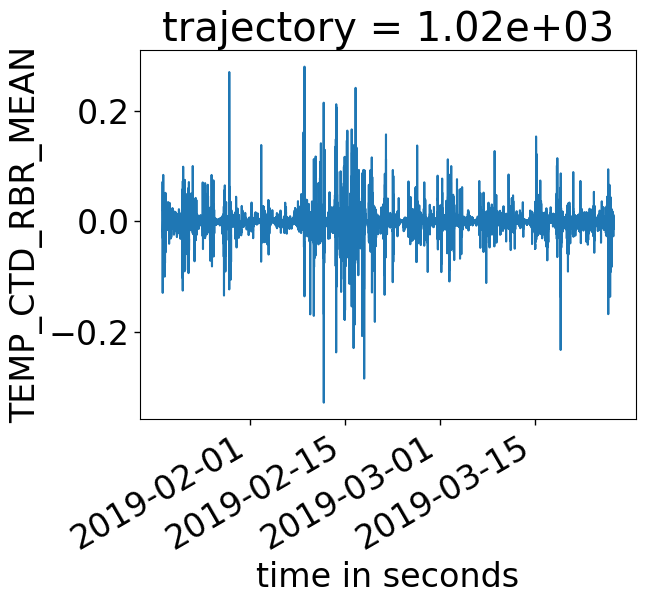

In [48]:
(ds5['TEMP_CTD_RBR_MEAN']-ds5['TEMP_CTD_RBR_MEAN'].rolling(time=int(4),center=True).mean('time')).plot()

Text(0.5, 1.0, '')

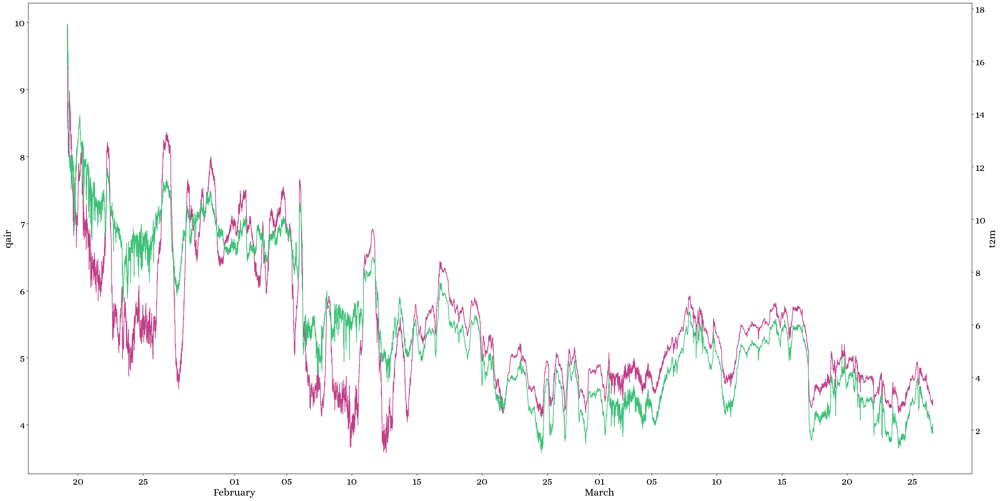

In [14]:
fig, ax = plt.subplots(1, 1, figsize=(32, 16), constrained_layout=True, dpi=150)
bx=ax.twinx()
ds5["qair"].plot(c=c20,ax=ax)
ds5["t2m"].plot(ax=bx,c=c22)
my_funcs.fix_xticks([ax],ds5)
ax.set_title('')
bx.set_title('')

Text(0.5, 1.0, '')

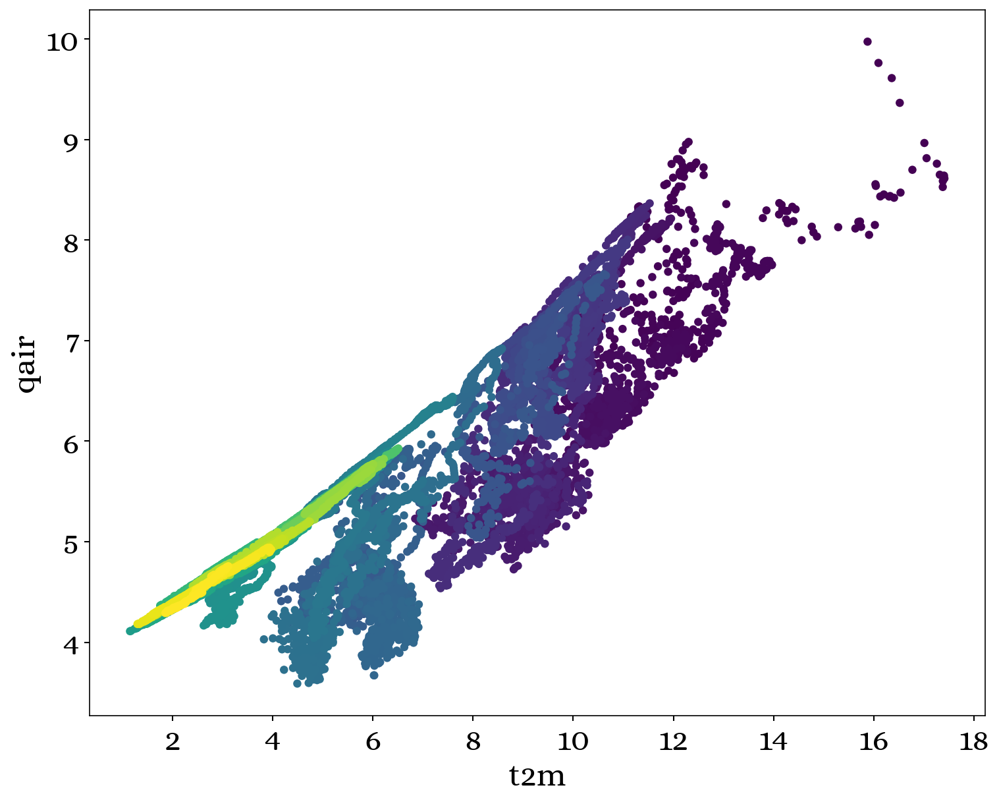

In [22]:
fig, ax = plt.subplots(1, 1, figsize=(10, 8), constrained_layout=True, dpi=150)

ds5.plot.scatter(x="t2m",y="qair",hue='time',add_colorbar=False,add_legend=False,hue_style="continuous",ec="None")
        
#my_funcs.fix_xticks([ax],ds5)
ax.set_title('')
bx.set_title('')

In [71]:
(ds5["TEMP_CTD_RBR_MEAN"].std()/np.sqrt(len(ds5["TEMP_CTD_RBR_MEAN"])))

<xarray.DataArray 'TEMP_CTD_RBR_MEAN' ()>
array(0.01998036)
Coordinates:
    trajectory  float32 ...

In [78]:
power_spectrum

NameError: name 'power_spectrum' is not defined

In [77]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

# Assuming ds5 is your xarray dataset containing SST data
# and TEMP_CTD_RBR_MEAN is the variable for sea surface temperature

# Step 1: Preprocessing (Assuming data is already loaded into ds5)

# Step 2: Detrending (Optional)
# Detrend the SST data if necessary
# ds5['TEMP_CTD_RBR_MEAN_detrended'] = ds5['TEMP_CTD_RBR_MEAN'] - ds5['TEMP_CTD_RBR_MEAN'].mean()

# Step 3: Windowing (Optional)
# You may choose a windowing function if needed, e.g., Hanning window
# window = np.hanning(len(ds5['TEMP_CTD_RBR_MEAN']))

# Step 4: Fast Fourier Transform (FFT)
# Perform FFT along the time dimension
sst_fft = xrft.fft(ds5['TEMP_CTD_RBR_MEAN'], dim='time', true_phase=False)

# Step 5: Power Spectrum Calculation
# Compute the power spectrum (squared magnitude of FFT output)
power_spectrum = (sst_fft * sst_fft.conj()).mean(dim='time')

# Step 6: Wavenumber Calculation
# Convert frequency domain to wavenumber domain
# Wavenumber (k) is related to frequency (f) by k = 2pi / lambda
# lambda is the corresponding wavelength
wavenumber = 2 * np.pi / power_spectrum

# Step 7: Plotting
plt.figure(figsize=(8, 6))
plt.loglog(wavenumber, power_spectrum, marker='o', linestyle='-', color='b')
plt.xlabel('Wavenumber (k)')
plt.ylabel('Power Spectrum')
plt.title('Wavenumber Spectrum of Sea Surface Temperature')
plt.grid(True)
plt.show()


ValueError: 'time' not found in array dimensions ('freq_time',)

In [75]:
import xrft

In [74]:
pip install xrft

Note: you may need to restart the kernel to use updated packages.
